<a href="https://colab.research.google.com/github/anh1811/trajectory-prediction/blob/main/LSTM_Skipconnection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [47]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import os
import torch
from torch.utils.data import TensorDataset, DataLoader,  SequentialSampler
from sklearn.model_selection import train_test_split
from torch import nn
from torch.optim.lr_scheduler import ReduceLROnPlateau
from tqdm.notebook import tqdm
from torch.nn import functional as F
from torch.utils.tensorboard import SummaryWriter
from time import time
from prettytable import PrettyTable

In [116]:
import matplotlib
print(np.__version__)
print(cv2.__version__)
print(matplotlib.__version__)
print(torch.__version__)
import sklearn
import prettytable
print(sklearn.__version__)
print(prettytable.__version__)

1.21.6
4.1.2
3.2.2
1.11.0+cu113
1.0.2
3.3.0


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!sudo add-apt-repository -y ppa:alessandro-strada/ppa 2>&1 > /dev/null
!sudo apt-get update -qq 2>&1 > /dev/null
!sudo apt -y install -qq google-drive-ocamlfuse 2>&1 > /dev/null
!google-drive-ocamlfuse



debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 76, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
/usr/bin/xdg-open: 851: /usr/bin/xdg-open: www-browser: not found
/usr/bin/xdg-open: 851: /usr/bin/xdg-open: links2: not found
/usr/bin/xdg-open: 851: /usr/bin/xdg-open: elinks: not found
/usr/bin/xdg-open: 851: /usr/bin/xdg-open: links: not found
/usr/bin/xdg-open: 851: /usr/bin/xdg-open: lynx: not found
/usr/bin/xdg-open: 851: /usr/bin/xdg-open: w3m: not found
xdg-open: no method available for opening 'https://accounts.google.com/o/oauth2/auth?client_id=564921029129.apps.googleusercontent.com&redirect_uri=https%3A%2F%2Fgd-ocaml-auth.appspot.

In [ ]:
!sudo apt-get install -qq w3m # to act as web browser 
!xdg-settings set default-web-browser w3m.desktop # to set default browser
%cd /content
!mkdir drive
%cd drive
!mkdir MyDrive
%cd ..
%cd ..
!google-drive-ocamlfuse /content/drive/MyDrive

debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 76, <> line 2.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
Selecting previously unselected package libgpm2:amd64.
(Reading database ... 155644 files and directories currently installed.)
Preparing to unpack .../libgpm2_1.20.7-5_amd64.deb ...
Unpacking libgpm2:amd64 (1.20.7-5) ...
Selecting previously unselected package w3m.
Preparing to unpack .../w3m_0.5.3-36build1_amd64.deb ...
Unpacking w3m (0.5.3-36build1) ...
Setting up libgpm2:amd64 (1.20.7-5) ...
Setting up w3m (0.5.3-36build1) ...
Processing triggers for mime-support (3.60ubuntu1) ...
Processing triggers for libc-bin (2.27-3ubuntu1.3) ...
/sbin/

#DataSet

In [3]:
# %cd content
# %cd /content/drive/MyDrive/viettle/miniproject/sequencer
%cd /content/drive/MyDrive

/content/drive/MyDrive


In [4]:
from pycocotools.coco import COCO
import os
root_dir = 'tracking'
coco_annotation_file_path = os.path.join(root_dir, 'train.json')
coco_test_annotation_file_path = os.path.join(root_dir, 'val.json')
coco_annotation = COCO(annotation_file=coco_annotation_file_path)
coco_test_annotation = COCO(annotation_file=coco_test_annotation_file_path)

loading annotations into memory...
Done (t=2.99s)
creating index...
index created!
loading annotations into memory...
Done (t=0.76s)
creating index...
index created!


In [5]:
def xywh2xyxy(bbox):
  return bbox[0], bbox[1], bbox[2] + bbox[0], bbox[3] + bbox[1]


def xywh2cxcy(bbox):
  return bbox[0] + bbox[2]/2.0, bbox[1] + bbox[3]/2.0, bbox[2], bbox[3]

def Euclipe_dis(bbox1, bbox2):
  return np.sqrt((bbox1[0] - bbox2[0])**2 + (bbox1[1] - bbox2[1])**2)

def scale(bbox, h_pic = 1920, w_pic = 2560):
  if len(bbox) == 2:
    return bbox[0]/w_pic, bbox[1]/h_pic
  else: 
    return bbox[0]/w_pic, bbox[1]/h_pic, bbox[2]/w_pic, bbox[3]/h_pic

def checknois(bboxes):
  num_noise = 0
  for i in range(len(bboxes)-1):
    if Euclipe_dis(bboxes[i], bboxes[i+1]) > 0.1:
      num_noise += 1
  if num_noise >= 2:
    return True
  else:
    return False

def xywh2cxcyah(bbox):
  return bbox[0] + bbox[2]/2.0, bbox[1] + bbox[3]/2.0, bbox[3]/bbox[2], bbox[3]

def batch_xyxy2cxcy(bboxes):
  batch_size = bboxes.size(0)
  bbox_cxcy = torch.empty((batch_size,2), dtype=torch.float32)
  bbox_cxcy[:,0] = (bboxes[:,0] + bboxes[:,2])/2.
  bbox_cxcy[:,1] = (bboxes[:,1] + bboxes[:,3])/2.
  return bbox_cxcy

def count_parameters(model):
    table = PrettyTable(["Modules", "Parameters"])
    total_params = 0
    for name, parameter in model.named_parameters():
        if not parameter.requires_grad: continue
        params = parameter.numel()
        table.add_row([name, params])
        total_params+=params
    print(table)
    print(f"Total Trainable Params: {total_params}")
    return total_params
    
def vid_path(x):
  return x[1]

In [6]:
def create_list_ID(coco_annotation, coco_test_annotation):
  list_ID = dict()
  vid_id = -1
  list_bbox = coco_annotation.getAnnIds()
  list_test_bbox = coco_test_annotation.getAnnIds()
  list_overall = list_bbox + list_test_bbox
  list_overall.sort()
  
  for i,bbox in enumerate(list_overall):
    try:
      bbox_info = coco_annotation.loadAnns([bbox])[0]
    except:
      bbox_info = coco_test_annotation.loadAnns([bbox])[0] 
    track_id = bbox_info['attributes']['track_id'] 
    try:
      img = coco_annotation.loadImgs([bbox_info['image_id']])[0]
    except:
      img = coco_test_annotation.loadImgs([bbox_info['image_id']])[0]
    vid_path, img_path = img["file_name"].split('/')
    if i == 0 or vid_path != old_vid_path: 
      vid_id += 1
      old_vid_path = vid_path
    label = vid_path + "_{}".format(track_id)
    if label in list_ID.keys():
      list_ID[label].append([bbox, img_path])
    else:
      list_ID[label] = list()
      list_ID[label].append([bbox, img_path])
  return list_ID

In [7]:
def create_train_list(list_ID, len_seq):
  train_list = []
  for items in list_ID.items():
    id_for_one_obj = items[1]
    len_items = len(id_for_one_obj) 
    if len_items >= len_seq:
      for i,id in enumerate(id_for_one_obj[:-len_seq - 1]):
          train_list.append(list(id_for_one_obj[i:i+len_seq]))
      train_list.append(list(id_for_one_obj[-len_seq:]))
  return train_list

In [8]:
def create_dataset(train_list, coco_annotation, coco_test_annotation, type_box = 'xyxy', transformer = False):
  datas = list()
  labels = list()
  for seq in train_list:
    bbox_list = list()
    for pre in seq[:-1]:
      try:
        bbox_list.append(coco_annotation.loadAnns(pre)[0])
      except:
        bbox_list.append(coco_test_annotation.loadAnns(pre)[0])
    bbox_cxcy = [scale(xywh2cxcy(attr['bbox'])) for attr in bbox_list]
    bbox_seq = [scale(xywh2xyxy(attr['bbox'])) for attr in bbox_list]
    if np.var(bbox_cxcy) > 1e-5 and not checknois(bbox_cxcy):
      # bbox_seq = [xywh2xyxy(attr['bbox']) for attr in bbox_list]
      try:
        label = coco_annotation.loadAnns([seq[-1]])[0]['bbox']
      except:
        label = coco_test_annotation.loadAnns([seq[-1]])[0]['bbox']
      if type_box == 'xyxy':
        datas.append(bbox_seq)
        if transformer:
          label = bbox_seq[1:] + [scale(xywh2xyxy(label))]
        else:
          label = scale(xywh2xyxy(label))
        labels.append(label)
      elif type_box == 'cxcy':
        datas.append(bbox_cxcy)
        labels.append(scale(xywh2cxcy(label)))
      
  return np.array(datas, dtype='float32'), np.array(labels, dtype='float32')

In [9]:
def dataloader(X, y, batch_size = 128):
  inputs = torch.tensor(X)
  labels = torch.tensor(y)

  data = TensorDataset(inputs, labels)
  sampler = SequentialSampler(data)
  dataloader = DataLoader(data, sampler=sampler,batch_size=batch_size)

  return dataloader

#Karmal Filter


In [10]:
!pip install filterpy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 177 kB 8.8 MB/s 
  Created wheel for filterpy: filename=filterpy-1.4.5-py3-none-any.whl size=110474 sha256=db56202e80d9f93926c5a078b1dcb8e0f6361644c81dae17891f7ddd8432e1ff
  Stored in directory: /root/.cache/pip/wheels/ce/e0/ee/a2b3c5caab3418c1ccd8c4de573d4cbe13315d7e8b0a55fbc2
Successfully built filterpy


In [11]:
from filterpy.kalman import KalmanFilter
def convert_bbox_to_z(bbox):
  """
  Takes a bounding box in the form [x1,y1,x2,y2] and returns z in the form
    [x,y,s,r] where x,y is the centre of the box and s is the scale/area and r is
    the aspect ratio
  """
  w = bbox[2] - bbox[0]
  h = bbox[3] - bbox[1]
  x = bbox[0] + w/2.
  y = bbox[1] + h/2.
  s = w * h    #scale is just area
  r = w / float(h)
  return np.array([x, y, s, r]).reshape((4, 1))


def convert_x_to_bbox(x,score=None):
  """
  Takes a bounding box in the centre form [x,y,s,r] and returns it in the form
    [x1,y1,x2,y2] where x1,y1 is the top left and x2,y2 is the bottom right
  """
  w = np.sqrt(x[2] * x[3])
  h = x[2] / w
  if(score==None):
    return np.clip(np.array([x[0]-w/2.,x[1]-h/2.,x[0]+w/2.,x[1]+h/2.]), 0, None).reshape((1,4))
  else:
    return np.array([x[0]-w/2.,x[1]-h/2.,x[0]+w/2.,x[1]+h/2.,score]).reshape((1,5))

class KalmanBoxTracker(object):
  """
  This class represents the internal state of individual tracked objects observed as bbox.
  """
  count = 0
  def __init__(self,bbox):
    """
    Initialises a tracker using initial bounding box.
    """
    #define constant velocity model
    self.kf = KalmanFilter(dim_x=7, dim_z=4) 
    self.kf.F = np.array([[1,0,0,0,1,0,0],[0,1,0,0,0,1,0],[0,0,1,0,0,0,1],[0,0,0,1,0,0,0],  [0,0,0,0,1,0,0],[0,0,0,0,0,1,0],[0,0,0,0,0,0,1]])
    self.kf.H = np.array([[1,0,0,0,0,0,0],[0,1,0,0,0,0,0],[0,0,1,0,0,0,0],[0,0,0,1,0,0,0]])

    self.kf.R[2:,2:] *= 10.
    self.kf.P[4:,4:] *= 1000. #give high uncertainty to the unobservable initial velocities
    self.kf.P *= 10.
    self.kf.Q[-1,-1] *= 0.01
    self.kf.Q[4:,4:] *= 0.01

    self.kf.x[:4] = convert_bbox_to_z(bbox)
    self.time_since_update = 0
    self.id = KalmanBoxTracker.count
    KalmanBoxTracker.count += 1
    self.history = []
    self.hits = 0
    self.hit_streak = 0
    self.age = 0

  def update(self,bbox):
    """
    Updates the state vector with observed bbox.
    """
    self.time_since_update = 0
    self.history = []
    self.hits += 1
    self.hit_streak += 1
    self.kf.update(convert_bbox_to_z(bbox))

  def predict(self):
    """
    Advances the state vector and returns the predicted bounding box estimate.
    """
    if((self.kf.x[6]+self.kf.x[2])<=0):
      self.kf.x[6] *= 0.0
    self.kf.predict()
    self.age += 1
    if(self.time_since_update>0):
      self.hit_streak = 0
    self.time_since_update += 1
    self.history.append(convert_x_to_bbox(self.kf.x))
    return self.history[-1]

  def get_state(self):
    """
    Returns the current bounding box estimate.
    """
    return convert_x_to_bbox(self.kf.x)

In [12]:
# !pip install tensorflow_addons
# import tensorflow_addons as tfa
# metrics = tfa.losses.GIoULoss(mode = 'iou')

In [13]:
import numpy as np
import scipy.linalg
"""
Table for the 0.95 quantile of the chi-square distribution with N degrees of
freedom (contains values for N=1, ..., 9). Taken from MATLAB/Octave's chi2inv
function and used as Mahalanobis gating threshold.
"""
chi2inv95 = {
    1: 3.8415,
    2: 5.9915,
    3: 7.8147,
    4: 9.4877,
    5: 11.070,
    6: 12.592,
    7: 14.067,
    8: 15.507,
    9: 16.919}


class Kalman_Filter(object):
    """
    A simple Kalman filter for tracking bounding boxes in image space.
    The 8-dimensional state space
        x, y, a, h, vx, vy, va, vh
    contains the bounding box center position (x, y), aspect ratio a, height h,
    and their respective velocities.
    Object motion follows a constant velocity model. The bounding box location
    (x, y, a, h) is taken as direct observation of the state space (linear
    observation model).
    """

    def __init__(self):
        ndim, dt = 4, 1.

        # Create Kalman filter model matrices.
        self._motion_mat = np.eye(2 * ndim, 2 * ndim)
        for i in range(ndim):
            self._motion_mat[i, ndim + i] = dt
        self._update_mat = np.eye(ndim, 2 * ndim)

        # Motion and observation uncertainty are chosen relative to the current
        # state estimate. These weights control the amount of uncertainty in
        # the model. This is a bit hacky.
        self._std_weight_position = 1. / 20
        self._std_weight_velocity = 1. / 160

    def initiate(self, measurement):
        """Create track from unassociated measurement.
        Parameters
        ----------
        measurement : ndarray
            Bounding box coordinates (x, y, a, h) with center position (x, y),
            aspect ratio a, and height h.
        Returns
        -------
        (ndarray, ndarray)
            Returns the mean vector (8 dimensional) and covariance matrix (8x8
            dimensional) of the new track. Unobserved velocities are initialized
            to 0 mean.
        """
        mean_pos = measurement
        mean_vel = np.zeros_like(mean_pos)
        mean = np.r_[mean_pos, mean_vel]

        std = [
            2 * self._std_weight_position * measurement[3],
            2 * self._std_weight_position * measurement[3],
            1e-2,
            2 * self._std_weight_position * measurement[3],
            10 * self._std_weight_velocity * measurement[3],
            10 * self._std_weight_velocity * measurement[3],
            1e-5,
            10 * self._std_weight_velocity * measurement[3]]
        covariance = np.diag(np.square(std))
        return mean, covariance

    def predict(self, mean, covariance):
        """Run Kalman filter prediction step.
        Parameters
        ----------
        mean : ndarray
            The 8 dimensional mean vector of the object state at the previous
            time step.
        covariance : ndarray
            The 8x8 dimensional covariance matrix of the object state at the
            previous time step.
        Returns
        -------
        (ndarray, ndarray)
            Returns the mean vector and covariance matrix of the predicted
            state. Unobserved velocities are initialized to 0 mean.
        """
        std_pos = [
            self._std_weight_position * mean[3],
            self._std_weight_position * mean[3],
            1e-2,
            self._std_weight_position * mean[3]]
        std_vel = [
            self._std_weight_velocity * mean[3],
            self._std_weight_velocity * mean[3],
            1e-5,
            self._std_weight_velocity * mean[3]]
        motion_cov = np.diag(np.square(np.r_[std_pos, std_vel]))

        mean = np.dot(self._motion_mat, mean)
        covariance = np.linalg.multi_dot((
            self._motion_mat, covariance, self._motion_mat.T)) + motion_cov

        return mean, covariance

    def project(self, mean, covariance):
        """Project state distribution to measurement space.
        Parameters
        ----------
        mean : ndarray
            The state's mean vector (8 dimensional array).
        covariance : ndarray
            The state's covariance matrix (8x8 dimensional).
        Returns
        -------
        (ndarray, ndarray)
            Returns the projected mean and covariance matrix of the given state
            estimate.
        """
        std = [
            self._std_weight_position * mean[3],
            self._std_weight_position * mean[3],
            1e-1,
            self._std_weight_position * mean[3]]
        innovation_cov = np.diag(np.square(std))

        mean = np.dot(self._update_mat, mean)
        covariance = np.linalg.multi_dot((
            self._update_mat, covariance, self._update_mat.T))
        return mean, covariance + innovation_cov

    def update(self, mean, covariance, measurement):
        """Run Kalman filter correction step.
        Parameters
        ----------
        mean : ndarray
            The predicted state's mean vector (8 dimensional).
        covariance : ndarray
            The state's covariance matrix (8x8 dimensional).
        measurement : ndarray
            The 4 dimensional measurement vector (x, y, a, h), where (x, y)
            is the center position, a the aspect ratio, and h the height of the
            bounding box.
        Returns
        -------
        (ndarray, ndarray)
            Returns the measurement-corrected state distribution.
        """
        projected_mean, projected_cov = self.project(mean, covariance)

        chol_factor, lower = scipy.linalg.cho_factor(
            projected_cov, lower=True, check_finite=False)
        kalman_gain = scipy.linalg.cho_solve(
            (chol_factor, lower), np.dot(covariance, self._update_mat.T).T,
            check_finite=False).T
        innovation = measurement - projected_mean

        new_mean = mean + np.dot(innovation, kalman_gain.T)
        new_covariance = covariance - np.linalg.multi_dot((
            kalman_gain, projected_cov, kalman_gain.T))
        return new_mean, new_covariance

    def gating_distance(self, mean, covariance, measurements,
                        only_position=False):
        """Compute gating distance between state distribution and measurements.
        A suitable distance threshold can be obtained from `chi2inv95`. If
        `only_position` is False, the chi-square distribution has 4 degrees of
        freedom, otherwise 2.
        Parameters
        ----------
        mean : ndarray
            Mean vector over the state distribution (8 dimensional).
        covariance : ndarray
            Covariance of the state distribution (8x8 dimensional).
        measurements : ndarray
            An Nx4 dimensional matrix of N measurements, each in
            format (x, y, a, h) where (x, y) is the bounding box center
            position, a the aspect ratio, and h the height.
        only_position : Optional[bool]
            If True, distance computation is done with respect to the bounding
            box center position only.
        Returns
        -------
        ndarray
            Returns an array of length N, where the i-th element contains the
            squared Mahalanobis distance between (mean, covariance) and
            `measurements[i]`.
        """
        mean, covariance = self.project(mean, covariance)
        if only_position:
            mean, covariance = mean[:2], covariance[:2, :2]
            measurements = measurements[:, :2]

        cholesky_factor = np.linalg.cholesky(covariance)
        d = measurements - mean
        z = scipy.linalg.solve_triangular(
            cholesky_factor, d.T, lower=True, check_finite=False,
            overwrite_b=True)
        squared_maha = np.sum(z * z, axis=0)
        return squared_maha

In [14]:
%load_ext tensorboard
%tensorboard --logdir ..output/graph

<IPython.core.display.Javascript object>

#Evaluation

In [15]:
def calculate_infer(model, batch_size, x_train, y_train):
  device = torch.device("cuda")
  dummy_input = torch.randn(1,5,4, dtype=torch.float).to(device)
  data_test = list()
  starter, ender = torch.cuda.Event(enable_timing=True), torch.cuda.Event(enable_timing=True)
  batch_size = batch_size 
  infer_time = list()
  model.eval()
  with torch.no_grad():
    for _ in range(10):
      _ = model(dummy_input)
    for i, batch in enumerate(batch_size):
      train_loader = dataloader(x_train, y_train, batch)
      data_iter = iter(train_loader)
      frame = next(data_iter)
      data_test.append(frame[0])    
      data = data_test[i].cuda()
      time = list()
      for rep in range(100):
        starter.record()
        _ = model(data)
        ender.record()
        # WAIT FOR GPU SYNC
        torch.cuda.synchronize()
        curr_time = starter.elapsed_time(ender)
        time.append(curr_time)
      infer_time.append(np.sum(time)/100)
  return [time/batch*1000 for (time, batch) in zip(infer_time, batch_size)], data_test

In [18]:
def cal_infer_kalman(data_test, batch_size):
  infer_time = list()
  starter, ender = torch.cuda.Event(enable_timing=True), torch.cuda.Event(enable_timing=True)
  for i,batch in enumerate(batch_size):
    data = np.array(data_test[i].cpu())
    time = list()
    for rep in range(100):
      starter.record()
      for i in range(batch):
        x = list(data[i])
        kalman = Kalman_Filter()
        mean, var = kalman.initiate(xywh2cxcyah(x[0]))
        for seq in x[1:]:
          mean, var = kalman.predict(mean, var)
          kalman.update(mean, var, xywh2cxcyah(seq))
        predict = kalman.predict(mean, var)
      ender.record()
      torch.cuda.synchronize()
      curr_time = starter.elapsed_time(ender)
      time.append(curr_time)
    infer_time.append(np.sum(time)/100)
  return [time/batch *1000 for (time, batch) in zip(infer_time, batch_size)]

In [19]:
def generalized_iou(gt_bboxes, pr_bboxes, reduction='mean'):
    """
    gt_bboxes: tensor (-1, 4) xyxy
    pr_bboxes: tensor (-1, 4) xyxy
    loss proposed in the paper of giou
    """
    gt_area = (gt_bboxes[:, 2]-gt_bboxes[:, 0])*(gt_bboxes[:, 3]-gt_bboxes[:, 1])
    pr_area = (pr_bboxes[:, 2]-pr_bboxes[:, 0])*(pr_bboxes[:, 3]-pr_bboxes[:, 1])

    # iou
    lt = torch.max(gt_bboxes[:, :2], pr_bboxes[:, :2])
    rb = torch.min(gt_bboxes[:, 2:], pr_bboxes[:, 2:])
    TO_REMOVE = 0
    wh = (rb - lt + TO_REMOVE).clamp(min=0)
    inter = wh[:, 0] * wh[:, 1]
    union = gt_area + pr_area - inter
    iou = inter / union
    # # enclosure
    # lt = torch.min(gt_bboxes[:, :2], pr_bboxes[:, :2])
    # rb = torch.max(gt_bboxes[:, 2:], pr_bboxes[:, 2:])
    # wh = (rb - lt + TO_REMOVE).clamp(min=0)
    # enclosure = wh[:, 0] * wh[:, 1]

    # giou = iou - (enclosure-union)/enclosure
    # loss = 1. - giou
    if reduction == 'mean':
        iou = iou.mean()
    elif reduction == 'sum':
        iou =iou.sum()
    elif reduction == 'none':
        pass
    return iou

In [20]:
def plot_infer(average_time, average_time_kalman, batch):
  plt.figure(figsize=(20, 10))
  plt.subplot(122)
  plt.plot(batch, average_time, label='LSTM-Skipconnection')
  plt.plot(batch, average_time_kalman,  label='KalmanFilter')
  plt.xlabel('batch')
  plt.ylabel('time in micro seconde')
  plt.legend()
  plt.show()

#Model

In [21]:
class LSTMRegression(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(LSTMRegression, self).__init__()

        # Defining the number of nodes in each layer
        self.hidden_dim = hidden_dim

        # LSTM layer
        self.lstm1 = nn.LSTM(input_dim, hidden_dim, batch_first=True)
        self.lstm2 = nn.LSTM(hidden_dim, hidden_dim, batch_first=True)
        self.lstm3 = nn.LSTM(2*hidden_dim, hidden_dim, batch_first=True)
        self.lstm4 = nn.LSTM(3*hidden_dim, hidden_dim, batch_first=True)
        self.lstm5 = nn.LSTM(4*hidden_dim, hidden_dim, batch_first=True)
        self.cnn1d = nn.Conv1d(in_channels=5*hidden_dim,out_channels=128, kernel_size=3, padding=1) # (64, 2048, 5) => (64, 128, 5)

        # Fully connected layer
        self.fc = nn.Linear(128, output_dim)
        self.sigmoid = nn.Sigmoid()
    
    def forward(self, x):
        h0, c0 = self.init_hidden(x)
        out1, (h1, c1) = self.lstm1(x, (h0, c0))
        out2, (h2, c2) = self.lstm2(out1, (h1, c1))
        x2 = torch.cat((out1, out2), 2)
        out3, (h3, c3) = self.lstm3(x2, (h2, c2))
        x3 = torch.cat((out1, out2, out3), 2)
        out4, (h4, c4) = self.lstm4(x3, (h3, c3))
        x4 = torch.cat((out1, out2, out3, out4), 2)
        out5, (h5, c5) = self.lstm5(x4, (h4, c4))
        x5 = torch.cat((out1, out2, out3, out4, out5), 2)
        x5 = torch.transpose(x5, 1, 2)
        out = self.cnn1d(x5)
        out = torch.tanh(out)
        out, indices = F.max_pool1d(out ,out.size(2), return_indices=True)
        out = out.squeeze()
        out = self.fc(out)
        out = self.sigmoid(out)

        return out
    
    def init_hidden(self, x):
        # Initializing hidden state for first input with zeros
        h0 = torch.zeros(1, x.size(0), self.hidden_dim)
        # Initializing cell state for first input with zeros
        c0 = torch.zeros(1, x.size(0), self.hidden_dim)
        return [t.cuda() for t in (h0, c0)]

In [22]:
class LSTMRegression8LSTM(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(LSTMRegression8LSTM, self).__init__()

        # Defining the number of nodes in each layer
        self.hidden_dim = hidden_dim

        # LSTM layer
        self.lstm1 = nn.LSTM(input_dim, hidden_dim, batch_first=True)
        self.lstm2 = nn.LSTM(hidden_dim, hidden_dim, batch_first=True)
        self.lstm3 = nn.LSTM(2*hidden_dim, hidden_dim, batch_first=True)
        self.lstm4 = nn.LSTM(3*hidden_dim, hidden_dim, batch_first=True)
        self.lstm5 = nn.LSTM(4*hidden_dim, hidden_dim, batch_first=True)
        self.lstm6 = nn.LSTM(5*hidden_dim, hidden_dim, batch_first=True)
        self.lstm7 = nn.LSTM(6*hidden_dim, hidden_dim, batch_first=True)
        self.lstm8 = nn.LSTM(7*hidden_dim, hidden_dim, batch_first=True)
        self.cnn1d = nn.Conv1d(in_channels=8*hidden_dim,out_channels=128, kernel_size=3, padding=1) # (64, 2048, 5) => (64, 128, 5)
        self.fc = nn.Linear(128, output_dim)
        self.sigmoid = nn.Sigmoid()
    
    def forward(self, x):
        h0, c0 = self.init_hidden(x)
        out1, (h1, c1) = self.lstm1(x, (h0, c0))
        out2, (h2, c2) = self.lstm2(out1, (h1, c1))
        x2 = torch.cat((out1, out2), 2)
        out3, (h3, c3) = self.lstm3(x2, (h2, c2))
        x3 = torch.cat((out1, out2, out3), 2)
        out4, (h4, c4) = self.lstm4(x3, (h3, c3))
        x4 = torch.cat((out1, out2, out3, out4), 2)
        out5, (h5, c5) = self.lstm5(x4, (h4, c4))
        x5 = torch.cat((out1, out2, out3, out4, out5), 2)
        out6, (h6, c6) = self.lstm6(x5, (h5, c5))
        x6 = torch.cat((out1, out2, out3, out4, out5, out6), 2)
        out7, (h7, c7) = self.lstm7(x6, (h6, c6))
        x7 = torch.cat((out1, out2, out3, out4, out5, out6, out7), 2)
        out8, (h8, c8) = self.lstm8(x7, (h7, c7))
        x8 = torch.cat((out1, out2, out3, out4, out5, out6, out7, out8), 2)
        x8 = torch.transpose(x8, 1, 2)
        out = self.cnn1d(x8)
        out = torch.tanh(out)
        out, indices = F.max_pool1d(out ,out.size(2), return_indices=True)
        out = out.squeeze()

        out = self.fc(out)
        out = self.sigmoid(out)

        return out
    
    def init_hidden(self, x):
        # Initializing hidden state for first input with zeros
        h0 = torch.zeros(1, x.size(0), self.hidden_dim)
        # Initializing cell state for first input with zeros
        c0 = torch.zeros(1, x.size(0), self.hidden_dim)
        return [t.cuda() for t in (h0, c0)]

In [23]:
class LSTM(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(LSTM, self).__init__()

        # Defining the number of nodes in each layer
        self.hidden_dim = hidden_dim

        # LSTM layer
        self.lstm = nn.LSTM(input_dim, hidden_dim, num_layers = 5, batch_first=True)
        # self.lstm6 = nn.LSTM(5*hidden_dim, hidden_dim, batch_first=True)
        # self.lstm7 = nn.LSTM(6*hidden_dim, hidden_dim, batch_first=True)
        # self.lstm8 = nn.LSTM(7*hidden_dim, hidden_dim, batch_first=True)
        # self.cnn1d = nn.Conv1d(in_channels=5*hidden_dim,out_channels=128, kernel_size=3, padding=1) # (64, 2048, 5) => (64, 128, 5)

        # Fully connected layer
        self.fc = nn.Linear(256, output_dim)
        self.sigmoid = nn.Sigmoid()
    
    def forward(self, x):
        h0, c0 = self.init_hidden(x)
        out, (h, c) = self.lstm(x, (h0, c0))
        out = torch.transpose(out, 1, 2) #(128,5,256) -> (128,256,5)
        out, indices = F.max_pool1d(out ,out.size(2), return_indices=True) #(128, 256 ,1)
        out = out.squeeze() #(128,256)
        out = self.fc(out)
        out = self.sigmoid(out)

        return out
    
    def init_hidden(self, x):
        # Initializing hidden state for first input with zeros
        h0 = torch.zeros(5, x.size(0), self.hidden_dim)
        # Initializing cell state for first input with zeros
        c0 = torch.zeros(5, x.size(0), self.hidden_dim)
        return [t.cuda() for t in (h0, c0)]

In [24]:
class LSTM_skipconnection(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(LSTM_skipconnection, self).__init__()

        # Defining the number of nodes in each layer
        self.hidden_dim = hidden_dim

        # LSTM layer
        self.lstm1 = nn.LSTM(input_dim, hidden_dim, batch_first=True)
        self.lstm2 = nn.LSTM(hidden_dim, hidden_dim, batch_first=True)
        self.lstm3 = nn.LSTM(2*hidden_dim, hidden_dim, batch_first=True)
        self.lstm4 = nn.LSTM(3*hidden_dim, hidden_dim, batch_first=True)
        self.lstm5 = nn.LSTM(4*hidden_dim, hidden_dim, batch_first=True)

        # Fully connected layer
        self.fc = nn.Linear(5*256, output_dim)
        self.sigmoid = nn.Sigmoid()
    
    def forward(self, x):
        h0, c0 = self.init_hidden(x)
        out1, (h1, c1) = self.lstm1(x, (h0, c0))
        out2, (h2, c2) = self.lstm2(out1, (h1, c1))
        x2 = torch.cat((out1, out2), 2)
        out3, (h3, c3) = self.lstm3(x2, (h2, c2))
        x3 = torch.cat((out1, out2, out3), 2)
        out4, (h4, c4) = self.lstm4(x3, (h3, c3))
        x4 = torch.cat((out1, out2, out3, out4), 2)
        out5, (h5, c5) = self.lstm5(x4, (h4, c4))
        x5 = torch.cat((out1, out2, out3, out4, out5), 2)
        # out6, (h6, c6) = self.lstm6(x5, (h5, c5))
        # x6 = torch.cat((out1, out2, out3, out4, out5, out6), 2)
        # out7, (h7, c7) = self.lstm7(x6, (h6, c6))
        # x7 = torch.cat((out1, out2, out3, out4, out5, out6, out7), 2)
        # out8, (h8, c8) = self.lstm8(x7, (h7, c7))
        # x8 = torch.cat((out1, out2, out3, out4, out5, out6, out7, out8), 2)
        x5 = torch.transpose(x5, 1, 2) #(128,5*256,5)
        # out = self.cnn1d(x5)
        # out = torch.tanh(out)
        out, indices = F.max_pool1d(x5 ,x5.size(2), return_indices=True)
        out = out.squeeze()
        out = self.fc(out)
        out = self.sigmoid(out)

        return out
    
    def init_hidden(self, x):
        # Initializing hidden state for first input with zeros
        h0 = torch.zeros(1, x.size(0), self.hidden_dim)
        # Initializing cell state for first input with zeros
        c0 = torch.zeros(1, x.size(0), self.hidden_dim)
        return [t.cuda() for t in (h0, c0)]

In [25]:
class LSTM_conv1D(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(LSTM_conv1D, self).__init__()

        # Defining the number of nodes in each layer
        self.hidden_dim = hidden_dim

        # LSTM layer
        self.lstm = nn.LSTM(input_dim, hidden_dim, num_layers = 5, batch_first=True)
        # self.lstm6 = nn.LSTM(5*hidden_dim, hidden_dim, batch_first=True)
        # self.lstm7 = nn.LSTM(6*hidden_dim, hidden_dim, batch_first=True)
        # self.lstm8 = nn.LSTM(7*hidden_dim, hidden_dim, batch_first=True)
        self.cnn1d = nn.Conv1d(in_channels=hidden_dim,out_channels=128, kernel_size=3, padding=1) # (64, 2048, 5) => (64, 128, 5)

        # Fully connected layer
        self.fc = nn.Linear(128, output_dim)
        self.sigmoid = nn.Sigmoid()
    
    def forward(self, x):
        h0, c0 = self.init_hidden(x)
        out, (h, c) = self.lstm(x, (h0, c0))
        out = torch.transpose(out, 1, 2) #(128,5,256) -> (128,256,5)
        out = self.cnn1d(out)
        out = torch.tanh(out)
        out, indices = F.max_pool1d(out ,out.size(2), return_indices=True) #(128, 256 ,1)
        out = out.squeeze() #(128,256)

        out = self.fc(out)
        out = self.sigmoid(out)

        return out
    
    def init_hidden(self, x):
        # Initializing hidden state for first input with zeros
        h0 = torch.zeros(5, x.size(0), self.hidden_dim)
        # Initializing cell state for first input with zeros
        c0 = torch.zeros(5, x.size(0), self.hidden_dim)
        return [t.cuda() for t in (h0, c0)]

#Loss 


In [26]:
import math
import warnings
def ciou_loss(pred, target, eps=1e-6, reduction='mean'):
    """`Implementation of paper `Enhancing Geometric Factors into
    Model Learning and Inference for Object Detection and Instance
    Segmentation <https://arxiv.org/abs/2005.03572>`_.

    Code is modified from https://github.com/Zzh-tju/CIoU.

    Args:
        pred (Tensor): Predicted bboxes of format (x1, y1, x2, y2),
            shape (n, 4).
        target (Tensor): Corresponding gt bboxes, shape (n, 4).
        eps (float): Eps to avoid log(0).
    Return:
        Tensor: Loss tensor.
    """
    # overlap
    lt = torch.max(pred[:, :2], target[:, :2])
    rb = torch.min(pred[:, 2:], target[:, 2:])
    wh = (rb - lt).clamp(min=0)
    overlap = wh[:, 0] * wh[:, 1]

    # union
    ap = (pred[:, 2] - pred[:, 0]) * (pred[:, 3] - pred[:, 1])
    ag = (target[:, 2] - target[:, 0]) * (target[:, 3] - target[:, 1])
    union = ap + ag - overlap + eps

    ious = overlap / union

    # enclose area
    enclose_x1y1 = torch.min(pred[:, :2], target[:, :2])
    enclose_x2y2 = torch.max(pred[:, 2:], target[:, 2:])
    enclose_wh = (enclose_x2y2 - enclose_x1y1).clamp(min=0)

    cw = enclose_wh[:, 0]
    ch = enclose_wh[:, 1]

    c2 = cw**2 + ch**2 + eps

    b1_x1, b1_y1 = pred[:, 0], pred[:, 1]
    b1_x2, b1_y2 = pred[:, 2], pred[:, 3]
    b2_x1, b2_y1 = target[:, 0], target[:, 1]
    b2_x2, b2_y2 = target[:, 2], target[:, 3]

    w1, h1 = b1_x2 - b1_x1, b1_y2 - b1_y1 + eps
    w2, h2 = b2_x2 - b2_x1, b2_y2 - b2_y1 + eps

    left = ((b2_x1 + b2_x2) - (b1_x1 + b1_x2))**2 / 4
    right = ((b2_y1 + b2_y2) - (b1_y1 + b1_y2))**2 / 4
    rho2 = left + right

    factor = 4 / math.pi**2
    v = factor * torch.pow(torch.atan(w2 / h2) - torch.atan(w1 / h1), 2)

    with torch.no_grad():
        alpha = (ious > 0.5).float() * v / (1 - ious + v)

    # CIoU
    cious = ious - (rho2 / c2 + alpha * v)
    loss = 1 - cious.clamp(min=-1.0, max=1.0)
    if reduction == 'mean':
        loss = loss.mean()
    elif reduction == 'sum':
        loss = loss.sum()
    elif reduction == 'none':
        pass
    return loss


class CIoULoss(nn.Module):

    def __init__(self, eps=1e-6, reduction='mean', loss_weight=1.0):
        super(CIoULoss, self).__init__()
        self.eps = eps
        self.reduction = reduction
        self.loss_weight = loss_weight

    def forward(self,
                pred,
                target,
                weight=None,
                avg_factor=None,
                reduction_override=None,
                **kwargs):
        if weight is not None and not torch.any(weight > 0):
            if pred.dim() == weight.dim() + 1:
                weight = weight.unsqueeze(1)
            return (pred * weight).sum()  # 0
        assert reduction_override in (None, 'none', 'mean', 'sum')
        reduction = (
            reduction_override if reduction_override else self.reduction)
        if weight is not None and weight.dim() > 1:
            assert weight.shape == pred.shape
            weight = weight.mean(-1)
        loss = self.loss_weight * ciou_loss(
            pred,
            target,
            eps=self.eps,
            reduction=reduction,
        )
        return loss

In [27]:
class LossMSE_YOLOv1(nn.Module):

  def __init__(self, reduction = 'mean'):
      super(LossMSE_YOLOv1, self).__init__()
      self.mse = nn.MSELoss(reduction = reduction)
  
  def forward(self, prediction, target):
    loss = self.mse(prediction[:,:2], target[:,:2]) + self.mse(torch.sqrt(prediction[:,2:4]),torch.sqrt(target[:,2:4]))
    return loss.float()

In [28]:
def train(model, X_train, y_train, X_val, y_val, lr, epochs, writer, path_save, loss_type = 'ciou', patience = 12, transformer = False):
  train_dataloader = dataloader(X_train, y_train)
  val_dataloader = dataloader(X_val, y_val)

  if loss_type == 'ciou':
    criterion = CIoULoss()
  elif loss_type == 'mse':
    criterion = LossMSE_YOLOv1()
  # metric = generalized_iou_loss
  opt = torch.optim.Adam(model.parameters(), lr=lr)
  sched = ReduceLROnPlateau(opt, threshold=1e-4, min_lr=1e-7, patience = patience)

  patience, trials = 25, 0
  val_loss_min = 100

  for epoch in range(epochs):
    print('======== Epoch {:} ========'.format(epoch + 1))

    total_loss = 0
    model.train()

    for step, batch in tqdm(enumerate(train_dataloader)):
      x_batch = batch[0].cuda()
      y_batch = batch[1].cuda()
      opt.zero_grad()
      out = model(x_batch)
      if transformer:
        num_fea = out.size(2)
        out = out.view(-1, num_fea)
        y_batch = y_batch.view(-1, num_fea)
      loss = criterion(out, y_batch)
      total_loss += loss.item()


      
      loss.backward()
      opt.step()

    train_loss = total_loss / len(train_dataloader)


    model.eval()
    total_val_loss = 0
    val_iou_loss = 0

    with torch.no_grad():
      for batch in tqdm(val_dataloader):
        x_val = batch[0].cuda()
        y_val = batch[1].cuda()
        out = model(x_val)
        if transformer:
          num_fea = out.size(2)
          out = out.view(-1, num_fea)
          y_val = y_val.view(-1, num_fea)
        loss = criterion(out, y_val)
        total_val_loss += loss.item()
      
      val_loss = total_val_loss/len(val_dataloader)
      sched.step(val_loss)

    if val_loss < val_loss_min:
        trials = 0
        torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
            }, path_save)
        val_loss_min = val_loss
    else:
        trials += 1
        if trials >= patience:
            print(f'Early stopping on epoch {epoch + 1}')
            break
    

    print('Epoch[{}/{}]: train_loss: {:.10f}, val_loss:{:.10f}'.format(epoch, epochs, train_loss, val_loss))
    #add to tensorboard
    writer.add_scalars(f'loss traing', {
        'train': train_loss,
        'val': val_loss,
    }, epoch)
  return model

# Mô hình 3seq

In [29]:
#tạo dataset
num_frames_input = 4
list_ID = create_list_ID(coco_annotation, coco_test_annotation)
for key in list_ID.keys():
  list_ID[key].sort(key=vid_path)
  b = [a[0] for a in list_ID[key]]
  list_ID[key] = b
train_list = create_train_list(list_ID, num_frames_input)
x_scale, y_scale = create_dataset(train_list, coco_annotation, coco_test_annotation)

In [30]:
x_train, x_test, y_train, y_test = train_test_split(x_scale, y_scale, test_size=0.2, shuffle=True, random_state=42)
x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, test_size=0.2, shuffle = True, random_state=42)

In [35]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter('./output/5lstm_CIOULoss{}seq'.format(num_frames_input))
path_save = './output/5lstm_CIOULoss.bestweight{}'.format(num_frames_input)

In [36]:
input_dim = 4 
hidden_dim = 256
output_dim = 4

lr = 0.001
n_epochs = 200
model = LSTMRegression(input_dim, hidden_dim, output_dim)
model = model.cuda()

In [ ]:
model = train(model, x_train, y_train, x_val, y_val,lr = lr, epochs = n_epochs, writer = writer, path_save = path_save)

======== Epoch 1 ========


0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[0/200]: train_loss: 1.0142456881, val_loss:0.9873741742
======== Epoch 2 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[1/200]: train_loss: 0.9854495554, val_loss:0.9864824863
======== Epoch 3 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[2/200]: train_loss: 0.9444533199, val_loss:0.7028963330
======== Epoch 4 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[3/200]: train_loss: 0.5255602341, val_loss:0.4354306528
======== Epoch 5 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[4/200]: train_loss: 0.3938230108, val_loss:0.3130280472
======== Epoch 6 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[5/200]: train_loss: 0.3291119317, val_loss:0.2541424016
======== Epoch 7 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[6/200]: train_loss: 0.2918141042, val_loss:0.2660776521
======== Epoch 8 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[7/200]: train_loss: 0.2687587693, val_loss:0.2941566906
======== Epoch 9 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[8/200]: train_loss: 0.2573595320, val_loss:0.2615913005
======== Epoch 10 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[9/200]: train_loss: 0.2337914100, val_loss:0.2022378555
======== Epoch 11 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[10/200]: train_loss: 0.2301804586, val_loss:0.2298851248
======== Epoch 12 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[11/200]: train_loss: 0.2241024140, val_loss:0.2367440264
======== Epoch 13 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[12/200]: train_loss: 0.2241109479, val_loss:0.2230252827
======== Epoch 14 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[13/200]: train_loss: 0.2136864236, val_loss:0.2463320110
======== Epoch 15 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[14/200]: train_loss: 0.2117750832, val_loss:0.2474533743
======== Epoch 16 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[15/200]: train_loss: 0.2047650764, val_loss:0.2244567690
======== Epoch 17 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[16/200]: train_loss: 0.2005813813, val_loss:0.2092487944
======== Epoch 18 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[17/200]: train_loss: 0.2008480956, val_loss:0.1680352065
======== Epoch 19 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[18/200]: train_loss: 0.1958854382, val_loss:0.1649367795
======== Epoch 20 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[19/200]: train_loss: 0.1938788123, val_loss:0.2107099731
======== Epoch 21 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[20/200]: train_loss: 0.1951318283, val_loss:0.1789281134
======== Epoch 22 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[21/200]: train_loss: 0.1926941828, val_loss:0.1971521149
======== Epoch 23 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[22/200]: train_loss: 0.1929586894, val_loss:0.1499302153
======== Epoch 24 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[23/200]: train_loss: 0.1820115622, val_loss:0.2205355969
======== Epoch 25 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[24/200]: train_loss: 0.1849990531, val_loss:0.1771227443
======== Epoch 26 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[25/200]: train_loss: 0.1788994473, val_loss:0.1682280081
======== Epoch 27 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[26/200]: train_loss: 0.1793764100, val_loss:0.1439247862
======== Epoch 28 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[27/200]: train_loss: 0.1764868842, val_loss:0.1581876089
======== Epoch 29 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[28/200]: train_loss: 0.1764459226, val_loss:0.1512619174
======== Epoch 30 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[29/200]: train_loss: 0.1737043239, val_loss:0.1700576765
======== Epoch 31 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[30/200]: train_loss: 0.1721630138, val_loss:0.1420328639
======== Epoch 32 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[31/200]: train_loss: 0.1753862729, val_loss:0.1733835518
======== Epoch 33 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[32/200]: train_loss: 0.1730448284, val_loss:0.1522506520
======== Epoch 34 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[33/200]: train_loss: 0.1684623449, val_loss:0.1436577730
======== Epoch 35 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[34/200]: train_loss: 0.1686772763, val_loss:0.1831084664
======== Epoch 36 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[35/200]: train_loss: 0.1701396441, val_loss:0.1425867720
======== Epoch 37 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[36/200]: train_loss: 0.1684487946, val_loss:0.1630967167
======== Epoch 38 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[37/200]: train_loss: 0.1648400254, val_loss:0.1698420947
======== Epoch 39 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[38/200]: train_loss: 0.1656361486, val_loss:0.1679437868
======== Epoch 40 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[39/200]: train_loss: 0.1680970839, val_loss:0.1562235998
======== Epoch 41 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[40/200]: train_loss: 0.1633398982, val_loss:0.1803505904
======== Epoch 42 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[41/200]: train_loss: 0.1638735829, val_loss:0.1604927155
======== Epoch 43 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[42/200]: train_loss: 0.1639266608, val_loss:0.1622252502
======== Epoch 44 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[43/200]: train_loss: 0.1616058339, val_loss:0.1368059215
======== Epoch 45 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[44/200]: train_loss: 0.1633192279, val_loss:0.1901199933
======== Epoch 46 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[45/200]: train_loss: 0.1577752157, val_loss:0.1291435735
======== Epoch 47 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[46/200]: train_loss: 0.1591615654, val_loss:0.1641101911
======== Epoch 48 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[47/200]: train_loss: 0.1577154590, val_loss:0.1388112046
======== Epoch 49 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[48/200]: train_loss: 0.1575985284, val_loss:0.2110174236
======== Epoch 50 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[49/200]: train_loss: 0.1621286983, val_loss:0.1469137336
======== Epoch 51 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[50/200]: train_loss: 0.1585593269, val_loss:0.2099450165
======== Epoch 52 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[51/200]: train_loss: 0.1556473110, val_loss:0.1688692756
======== Epoch 53 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[52/200]: train_loss: 0.1568271978, val_loss:0.1391264723
======== Epoch 54 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[53/200]: train_loss: 0.1549253615, val_loss:0.1466501028
======== Epoch 55 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[54/200]: train_loss: 0.1516891896, val_loss:0.1854117661
======== Epoch 56 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[55/200]: train_loss: 0.1553168292, val_loss:0.1759225535
======== Epoch 57 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[56/200]: train_loss: 0.1564167697, val_loss:0.1422265654
======== Epoch 58 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[57/200]: train_loss: 0.1535351119, val_loss:0.1294579415
======== Epoch 59 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[58/200]: train_loss: 0.1512526242, val_loss:0.1382899973
======== Epoch 60 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[59/200]: train_loss: 0.0966058079, val_loss:0.1008480572
======== Epoch 61 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[60/200]: train_loss: 0.0953929807, val_loss:0.0975894341
======== Epoch 62 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[61/200]: train_loss: 0.0951602963, val_loss:0.0984580010
======== Epoch 63 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[62/200]: train_loss: 0.0946504075, val_loss:0.0967947775
======== Epoch 64 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[63/200]: train_loss: 0.0945265719, val_loss:0.0972031337
======== Epoch 65 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[64/200]: train_loss: 0.0945641214, val_loss:0.0981896128
======== Epoch 66 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[65/200]: train_loss: 0.0943050646, val_loss:0.0974171280
======== Epoch 67 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[66/200]: train_loss: 0.0941375545, val_loss:0.0958956478
======== Epoch 68 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[67/200]: train_loss: 0.0937890108, val_loss:0.0981652828
======== Epoch 69 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[68/200]: train_loss: 0.0936506364, val_loss:0.0961431452
======== Epoch 70 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[69/200]: train_loss: 0.0939260862, val_loss:0.0988991783
======== Epoch 71 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[70/200]: train_loss: 0.0933852752, val_loss:0.0976003496
======== Epoch 72 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[71/200]: train_loss: 0.0934055288, val_loss:0.0954594651
======== Epoch 73 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[72/200]: train_loss: 0.0934667376, val_loss:0.0975880638
======== Epoch 74 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[73/200]: train_loss: 0.0933800651, val_loss:0.0997738335
======== Epoch 75 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[74/200]: train_loss: 0.0931305245, val_loss:0.0952160924
======== Epoch 76 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[75/200]: train_loss: 0.0929543294, val_loss:0.1006188170
======== Epoch 77 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[76/200]: train_loss: 0.0932781596, val_loss:0.0980775692
======== Epoch 78 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[77/200]: train_loss: 0.0929963236, val_loss:0.0978083667
======== Epoch 79 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[78/200]: train_loss: 0.0934896256, val_loss:0.0955127793
======== Epoch 80 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[79/200]: train_loss: 0.0929129031, val_loss:0.0948777471
======== Epoch 81 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[80/200]: train_loss: 0.0931922405, val_loss:0.0974907801
======== Epoch 82 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[81/200]: train_loss: 0.0926330159, val_loss:0.0940366048
======== Epoch 83 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[82/200]: train_loss: 0.0926435625, val_loss:0.1009674815
======== Epoch 84 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[83/200]: train_loss: 0.0927161940, val_loss:0.1008794050
======== Epoch 85 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[84/200]: train_loss: 0.0926478921, val_loss:0.0962038624
======== Epoch 86 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[85/200]: train_loss: 0.0927584069, val_loss:0.1005278351
======== Epoch 87 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[86/200]: train_loss: 0.0926789609, val_loss:0.0962659174
======== Epoch 88 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[87/200]: train_loss: 0.0923199876, val_loss:0.0973368068
======== Epoch 89 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[88/200]: train_loss: 0.0926449821, val_loss:0.0942752887
======== Epoch 90 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[89/200]: train_loss: 0.0924850853, val_loss:0.0960700121
======== Epoch 91 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[90/200]: train_loss: 0.0926224121, val_loss:0.0967881426
======== Epoch 92 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[91/200]: train_loss: 0.0923771697, val_loss:0.0975657771
======== Epoch 93 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[92/200]: train_loss: 0.0926533839, val_loss:0.0936118107
======== Epoch 94 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[93/200]: train_loss: 0.0922882821, val_loss:0.0955647734
======== Epoch 95 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[94/200]: train_loss: 0.0925338411, val_loss:0.0988181688
======== Epoch 96 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[95/200]: train_loss: 0.0922696080, val_loss:0.0961760789
======== Epoch 97 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[96/200]: train_loss: 0.0922042375, val_loss:0.0967241429
======== Epoch 98 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[97/200]: train_loss: 0.0921102552, val_loss:0.0940684193
======== Epoch 99 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[98/200]: train_loss: 0.0923159871, val_loss:0.0945269915
======== Epoch 100 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[99/200]: train_loss: 0.0922181766, val_loss:0.0949678616
======== Epoch 101 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[100/200]: train_loss: 0.0921729733, val_loss:0.0998456699
======== Epoch 102 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[101/200]: train_loss: 0.0921757178, val_loss:0.0967397700
======== Epoch 103 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[102/200]: train_loss: 0.0924447506, val_loss:0.0952566543
======== Epoch 104 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[103/200]: train_loss: 0.0921146073, val_loss:0.0941746579
======== Epoch 105 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[104/200]: train_loss: 0.0918721121, val_loss:0.0954643315
======== Epoch 106 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[105/200]: train_loss: 0.0920578591, val_loss:0.0972215304
======== Epoch 107 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[106/200]: train_loss: 0.0878751329, val_loss:0.0908100622
======== Epoch 108 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[107/200]: train_loss: 0.0878104386, val_loss:0.0910227045
======== Epoch 109 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[108/200]: train_loss: 0.0878272114, val_loss:0.0909771215
======== Epoch 110 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[109/200]: train_loss: 0.0878085558, val_loss:0.0910582861
======== Epoch 111 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[110/200]: train_loss: 0.0877967693, val_loss:0.0910593122
======== Epoch 112 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[111/200]: train_loss: 0.0877784803, val_loss:0.0910711919
======== Epoch 113 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[112/200]: train_loss: 0.0877772182, val_loss:0.0910746912
======== Epoch 114 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[113/200]: train_loss: 0.0877665956, val_loss:0.0908516440
======== Epoch 115 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[114/200]: train_loss: 0.0877640668, val_loss:0.0907362096
======== Epoch 116 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[115/200]: train_loss: 0.0877380692, val_loss:0.0908907933
======== Epoch 117 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[116/200]: train_loss: 0.0877377234, val_loss:0.0909671450
======== Epoch 118 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[117/200]: train_loss: 0.0877236693, val_loss:0.0908682449
======== Epoch 119 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[118/200]: train_loss: 0.0877258649, val_loss:0.0906980266
======== Epoch 120 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[119/200]: train_loss: 0.0877116524, val_loss:0.0907262905
======== Epoch 121 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[120/200]: train_loss: 0.0876999781, val_loss:0.0907147808
======== Epoch 122 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[121/200]: train_loss: 0.0877016723, val_loss:0.0908091364
======== Epoch 123 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[122/200]: train_loss: 0.0876944359, val_loss:0.0910056805
======== Epoch 124 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[123/200]: train_loss: 0.0876764109, val_loss:0.0906656525
======== Epoch 125 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[124/200]: train_loss: 0.0876857256, val_loss:0.0907688728
======== Epoch 126 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[125/200]: train_loss: 0.0876635355, val_loss:0.0908800931
======== Epoch 127 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[126/200]: train_loss: 0.0876612693, val_loss:0.0911748564
======== Epoch 128 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[127/200]: train_loss: 0.0876586009, val_loss:0.0908814941
======== Epoch 129 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[128/200]: train_loss: 0.0876742776, val_loss:0.0906759440
======== Epoch 130 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[129/200]: train_loss: 0.0876425964, val_loss:0.0907907632
======== Epoch 131 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[130/200]: train_loss: 0.0876366475, val_loss:0.0906996369
======== Epoch 132 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[131/200]: train_loss: 0.0876465585, val_loss:0.0906619293
======== Epoch 133 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[132/200]: train_loss: 0.0876169937, val_loss:0.0906006188
======== Epoch 134 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[133/200]: train_loss: 0.0876315699, val_loss:0.0907491780
======== Epoch 135 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[134/200]: train_loss: 0.0876108389, val_loss:0.0905789710
======== Epoch 136 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[135/200]: train_loss: 0.0875972936, val_loss:0.0905825080
======== Epoch 137 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[136/200]: train_loss: 0.0875935027, val_loss:0.0902538614
======== Epoch 138 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[137/200]: train_loss: 0.0875936277, val_loss:0.0905157272
======== Epoch 139 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[138/200]: train_loss: 0.0875917009, val_loss:0.0905117710
======== Epoch 140 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[139/200]: train_loss: 0.0876020311, val_loss:0.0905646025
======== Epoch 141 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[140/200]: train_loss: 0.0875827485, val_loss:0.0907560803
======== Epoch 142 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[141/200]: train_loss: 0.0875742040, val_loss:0.0903517718
======== Epoch 143 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[142/200]: train_loss: 0.0875605634, val_loss:0.0906089700
======== Epoch 144 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[143/200]: train_loss: 0.0875603345, val_loss:0.0905460992
======== Epoch 145 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[144/200]: train_loss: 0.0875746969, val_loss:0.0907690656
======== Epoch 146 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[145/200]: train_loss: 0.0875580950, val_loss:0.0907281990
======== Epoch 147 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[146/200]: train_loss: 0.0875671144, val_loss:0.0904642108
======== Epoch 148 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[147/200]: train_loss: 0.0875516698, val_loss:0.0904699740
======== Epoch 149 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[148/200]: train_loss: 0.0875411322, val_loss:0.0904452303
======== Epoch 150 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[149/200]: train_loss: 0.0875452235, val_loss:0.0909427176
======== Epoch 151 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[150/200]: train_loss: 0.0869777867, val_loss:0.0898494958
======== Epoch 152 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[151/200]: train_loss: 0.0869580999, val_loss:0.0898615767
======== Epoch 153 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[152/200]: train_loss: 0.0869550261, val_loss:0.0898677090
======== Epoch 154 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[153/200]: train_loss: 0.0869530361, val_loss:0.0898705302
======== Epoch 155 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[154/200]: train_loss: 0.0869511524, val_loss:0.0898690040
======== Epoch 156 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[155/200]: train_loss: 0.0869490890, val_loss:0.0898865357
======== Epoch 157 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[156/200]: train_loss: 0.0869466807, val_loss:0.0898584157
======== Epoch 158 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[157/200]: train_loss: 0.0869459412, val_loss:0.0898626484
======== Epoch 159 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[158/200]: train_loss: 0.0869444933, val_loss:0.0898757087
======== Epoch 160 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[159/200]: train_loss: 0.0869442495, val_loss:0.0898496981
======== Epoch 161 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[160/200]: train_loss: 0.0869429232, val_loss:0.0898702234
======== Epoch 162 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[161/200]: train_loss: 0.0869412805, val_loss:0.0898549526
======== Epoch 163 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[162/200]: train_loss: 0.0869404183, val_loss:0.0898682074
======== Epoch 164 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[163/200]: train_loss: 0.0869385186, val_loss:0.0898668082
======== Epoch 165 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[164/200]: train_loss: 0.0868716296, val_loss:0.0897449784
======== Epoch 166 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[165/200]: train_loss: 0.0868678323, val_loss:0.0897439061
======== Epoch 167 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[166/200]: train_loss: 0.0868671138, val_loss:0.0897440555
======== Epoch 168 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[167/200]: train_loss: 0.0868667685, val_loss:0.0897437791
======== Epoch 169 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[168/200]: train_loss: 0.0868663884, val_loss:0.0897439840
======== Epoch 170 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[169/200]: train_loss: 0.0868662003, val_loss:0.0897438470
======== Epoch 171 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[170/200]: train_loss: 0.0868660303, val_loss:0.0897439370
======== Epoch 172 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[171/200]: train_loss: 0.0868657664, val_loss:0.0897439822
======== Epoch 173 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[172/200]: train_loss: 0.0868655354, val_loss:0.0897438855
======== Epoch 174 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[173/200]: train_loss: 0.0868653337, val_loss:0.0897441068
======== Epoch 175 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[174/200]: train_loss: 0.0868651631, val_loss:0.0897442218
======== Epoch 176 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[175/200]: train_loss: 0.0868649846, val_loss:0.0897442849
======== Epoch 177 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[176/200]: train_loss: 0.0868648479, val_loss:0.0897440706
======== Epoch 178 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[177/200]: train_loss: 0.0868646236, val_loss:0.0897443006
======== Epoch 179 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[178/200]: train_loss: 0.0868644870, val_loss:0.0897440523
======== Epoch 180 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[179/200]: train_loss: 0.0868643146, val_loss:0.0897445467
======== Epoch 181 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[180/200]: train_loss: 0.0868642009, val_loss:0.0897442550
======== Epoch 182 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[181/200]: train_loss: 0.0868640502, val_loss:0.0897441470
======== Epoch 183 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[182/200]: train_loss: 0.0868639493, val_loss:0.0897442497
======== Epoch 184 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[183/200]: train_loss: 0.0868637977, val_loss:0.0897444321
======== Epoch 185 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[184/200]: train_loss: 0.0868636539, val_loss:0.0897441099
======== Epoch 186 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[185/200]: train_loss: 0.0868635478, val_loss:0.0897443136
======== Epoch 187 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[186/200]: train_loss: 0.0868634188, val_loss:0.0897442847
======== Epoch 188 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[187/200]: train_loss: 0.0868632578, val_loss:0.0897445710
======== Epoch 189 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[188/200]: train_loss: 0.0868631479, val_loss:0.0897441966
======== Epoch 190 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[189/200]: train_loss: 0.0868629628, val_loss:0.0897440383
======== Epoch 191 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[190/200]: train_loss: 0.0868628298, val_loss:0.0897442447
======== Epoch 192 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Epoch[191/200]: train_loss: 0.0868627655, val_loss:0.0897441458
======== Epoch 193 ========


0it [00:00, ?it/s]

  0%|          | 0/328 [00:00<?, ?it/s]

Early stopping on epoch 193


In [42]:
checkpoint = torch.load(path_save)
model.load_state_dict(checkpoint['model_state_dict'])
model = model.cuda()

In [43]:
batch_size = [2,4,8,16,32,64,128,512,1024]
average_time3, data_test = calculate_infer(model, batch_size, x_train, y_train)
print(average_time3)

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


[743.5144013166428, 352.27919965982437, 175.83232074975967, 83.83239969611168, 40.58404993265867, 21.291630193591118, 14.43174246698618, 9.871153738349676, 9.687576871365309]


In [44]:
model.eval()
with torch.no_grad():
  pred = model(torch.as_tensor(x_test).cuda())
  y_true = torch.as_tensor(y_test).cuda()
  loss = nn.MSELoss()
  print('mseLoss = {}'.format(loss(batch_xyxy2cxcy(pred), batch_xyxy2cxcy(y_true))))
  print('IOU = {}'.format(generalized_iou(y_true, pred)))

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


mseLoss = 3.585651938919909e-05
IOU = 0.9145272374153137


In [45]:
#inference
average_time_kalman3 = cal_infer_kalman(data_test, batch_size)

In [46]:
print(average_time_kalman3)

[438.0998393893242, 381.6389590501785, 357.7705204486847, 361.5927395224571, 367.63191163539886, 367.1380552649498, 401.79786294698715, 555.0927442312241, 390.01115322113037]


In [ ]:
y_predict = []
model.eval()
with torch.no_grad():
  for x in x_test:
    kalman = KalmanBoxTracker(x[0])
    for seq in x[1:]:
      kalman.predict()
      kalman.update(seq)
    y_predict.append(kalman.predict())

y_predict = np.array(y_predict)
y_predict = y_predict.squeeze()
loss = nn.MSELoss()
print('mseLoss = {}'.format(loss(batch_xyxy2cxcy(torch.from_numpy(y_test)), batch_xyxy2cxcy(torch.from_numpy(y_predict)))))
print('IOU = {}'.format(generalized_iou(torch.from_numpy(y_test), torch.from_numpy(y_predict))))

mseLoss = 4.750493462779559e-05
IOU = 0.8850985780370728


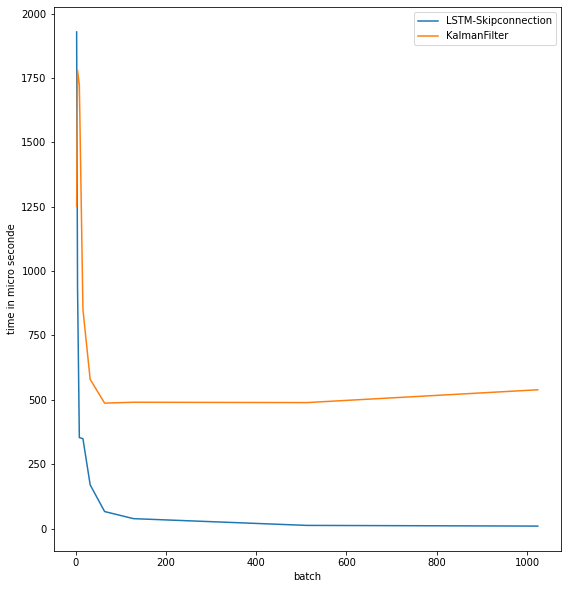

In [ ]:
plot_infer(average_time3, average_time_kalman3, batch_size)

# Mô hình 5seq

In [ ]:
#tạo dataset
num_frames_input = 6
list_ID = create_list_ID(coco_annotation, coco_test_annotation)
for key in list_ID.keys():
  list_ID[key].sort(key=vid_path)
  b = [a[0] for a in list_ID[key]]
  list_ID[key] = b
train_list = create_train_list(list_ID, num_frames_input)
x_scale, y_scale = create_dataset(train_list, coco_annotation, coco_test_annotation)

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(x_scale, y_scale, test_size=0.2, shuffle=True, random_state=42)
x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, test_size=0.2, shuffle = True, random_state=42)

In [ ]:
print(len(x_train))
print(len(x_val))
print(len(x_test))

162572
40644
50804


In [ ]:
writer = SummaryWriter('./output/5lstm_CIOULoss{}seq'.format(num_frames_input))
path_save = './output/5lstm_CIOULoss.bestweight{}'.format(num_frames_input)

In [ ]:
input_dim = 4 
hidden_dim = 256
output_dim = 4

lr = 0.001
n_epochs = 200

model = LSTMRegression(input_dim, hidden_dim, output_dim)
model = model.cuda()
model = train(model, x_train, y_train, x_val, y_val,lr = lr, epochs = n_epochs, writer = writer, path_save = path_save)

In [ ]:
checkpoint = torch.load(path_save)
model.load_state_dict(checkpoint['model_state_dict'])
model = model.cuda()

In [ ]:
batch_size = [2,4,8,16,32,64,128,512,1024]
average_time5, data_test = calculate_infer(model, batch_size, x_train, y_train)

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


In [ ]:
average_time5

[1484.9998378753662,
 752.4533540010452,
 295.635679513216,
 132.17528030276299,
 52.10726976394653,
 28.747975025326014,
 27.879107426851988,
 14.698165617883205,
 14.388194708153605]

In [ ]:
count_parameters(model)

4438660

In [ ]:
model.eval()
with torch.no_grad():
  pred = model(torch.as_tensor(x_test).cuda())
  y_true = torch.as_tensor(y_test).cuda()
  loss = nn.MSELoss()
  print('mseLoss = {}'.format(loss(batch_xyxy2cxcy(pred), batch_xyxy2cxcy(y_true))))
  print('IOU = {}'.format(generalized_iou(y_true, pred)))

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


mseLoss = 3.946128344978206e-05
IOU = 0.9163920879364014


In [ ]:
#inference
average_time_kalman5 = cal_infer_kalman(data_test, batch_size)

mseLoss = 6.412345450707856e-05
IOU = 0.8931830648536877
[910.2894395589828, 831.5392816066742, 815.0384414196014, 831.6708606481552, 807.4774783849716, 1760.623723268509, 895.1776683330536, 1029.8323863744736, 806.4761710166931]


In [ ]:
y_predict = []
model.eval()
with torch.no_grad():
  for x in x_test:
    kalman = KalmanBoxTracker(x[0])
    for seq in x[1:]:
      kalman.predict()
      kalman.update(seq)
    y_predict.append(kalman.predict())

y_predict = np.array(y_predict)
y_predict = y_predict.squeeze()
loss = nn.MSELoss()
print('mseLoss = {}'.format(loss(batch_xyxy2cxcy(torch.from_numpy(y_test)), batch_xyxy2cxcy(torch.from_numpy(y_predict)))))
print('IOU = {}'.format(generalized_iou(torch.from_numpy(y_test), torch.from_numpy(y_predict))))

mseLoss = 4.6246910642366856e-05
IOU = 0.8931830648536877


# Mô hình 7seq

In [ ]:
#tạo dataset
num_frames_input = 8
list_ID = create_list_ID(coco_annotation, coco_test_annotation)
for key in list_ID.keys():
  list_ID[key].sort(key=vid_path)
  b = [a[0] for a in list_ID[key]]
  list_ID[key] = b
train_list = create_train_list(list_ID, num_frames_input)
x_scale, y_scale = create_dataset(train_list, coco_annotation, coco_test_annotation)

In [ ]:
print(len(train_list))
print(len(x_scale))

245220
245171


In [ ]:
x_train, x_test, y_train,y_test = train_test_split(x_scale, y_scale, test_size=0.2, shuffle=True, random_state=42)
x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, test_size=0.2, shuffle = True, random_state=42)

In [ ]:
print(len(x_train))
print(len(x_val))
print(len(x_test))

156908
39228
49035


In [ ]:
writer = SummaryWriter('./output/5lstm_CIOULoss{}seq'.format(num_frames_input))
path_save = './output/5lstm_CIOULoss.bestweight{}'.format(num_frames_input)

In [ ]:
input_dim = 4 
hidden_dim = 256
output_dim = 4

lr = 0.001
n_epochs = 200
model = LSTMRegression(input_dim, hidden_dim, output_dim)
model = model.cuda()
# model = train(model, x_train, y_train, x_val, y_val,lr = lr, epochs = n_epochs, writer = writer, path_save = path_save)

In [ ]:
checkpoint = torch.load(path_save)
model.load_state_dict(checkpoint['model_state_dict'])
model = model.cuda()

In [ ]:
batch_size = [2,4,8,16,32,64,128,512,1024]
average_time7, data_test = calculate_infer(model,batch_size, x_train, y_train)

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


In [ ]:
average_time7

[899.4094377756119,
 460.8731210231781,
 196.30419999361038,
 224.7403422743082,
 57.01931972056627,
 32.27913472801447,
 25.40966236963868,
 20.85565436631441,
 19.850865956395864]

In [ ]:
count_parameters(model)

4438660

In [ ]:
model.eval()
with torch.no_grad():
  pred = model(torch.as_tensor(x_test).cuda())
  y_true = torch.as_tensor(y_test).cuda()
  loss = nn.MSELoss()
  print('mseLoss = {}'.format(loss(batch_xyxy2cxcy(pred), batch_xyxy2cxcy(y_true))))
  print('IOU = {}'.format(generalized_iou(y_true, pred)))

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


mseLoss = 2.789712743833661e-05
IOU = 0.9190038442611694


In [ ]:
#inference
average_time_kalman7 = cal_infer_kalman(data_test, batch_size)

In [ ]:
y_predict = []
model.eval()
with torch.no_grad():
  for x in x_test:
    kalman = KalmanBoxTracker(x[0])
    for seq in x[1:]:
      kalman.predict()
      kalman.update(seq)
    y_predict.append(kalman.predict())

y_predict = np.array(y_predict)
y_predict = y_predict.squeeze()
loss = nn.MSELoss()
print('mseLoss = {}'.format(loss(batch_xyxy2cxcy(torch.from_numpy(y_test)), batch_xyxy2cxcy(torch.from_numpy(y_predict)))))
print('IOU = {}'.format(generalized_iou(torch.from_numpy(y_test), torch.from_numpy(y_predict))))

mseLoss = 3.213732270523906e-05
IOU = 0.8935712734040063


In [ ]:
# plot_infer(average_time7, average_time_kalman7, batch_size)

# Mô hình 9seq

In [ ]:
#tạo dataset
num_frames_input = 10
list_ID = create_list_ID(coco_annotation, coco_test_annotation)
for key in list_ID.keys():
  list_ID[key].sort(key=vid_path)
  b = [a[0] for a in list_ID[key]]
  list_ID[key] = b
train_list = create_train_list(list_ID, num_frames_input)
x_scale, y_scale = create_dataset(train_list, coco_annotation, coco_test_annotation)

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(x_scale, y_scale, test_size=0.2, shuffle=True, random_state=42)
x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, test_size=0.2, shuffle = True, random_state=42)

In [ ]:
print(len(train_list))
print(len(x_scale))

In [ ]:
print(len(x_train))
print(len(x_val))
print(len(x_test))

151365
37842
47302


In [ ]:
train_loader = dataloader(x_train, y_train)
#test
data_iter = iter(train_loader)
frame = next(data_iter)

In [ ]:
writer = SummaryWriter('./output/5lstm_CIOULoss{}seq'.format(num_frames_input))
path_save = './output/5lstm_CIOULoss.bestweight{}'.format(num_frames_input)

In [ ]:
input_dim = 4 
hidden_dim = 256
output_dim = 4

lr = 0.001
n_epochs = 200
model = LSTMRegression(input_dim, hidden_dim, output_dim)
model = model.cuda()

In [ ]:
# model = train(model, x_train, y_train, x_val, y_val,lr = lr, epochs = n_epochs, writer = writer, path_save = path_save)

In [ ]:
checkpoint = torch.load(path_save)
model.load_state_dict(checkpoint['model_state_dict'])
model = model.cuda()

In [ ]:
batch_size = [2,4,8,16,32,64,128,512,1024]
average_time9, data_test = calculate_infer(model, x_train, y_train)

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


In [ ]:
average_time9

[983.6103999614716,
 422.5253587961197,
 209.48920026421547,
 106.82605974376202,
 59.480980187654495,
 37.25904505699873,
 33.662127424031496,
 27.769523803144693,
 27.50201089307666]

In [ ]:
count_parameters(model)

4438660

In [ ]:
model.eval()
with torch.no_grad():
  pred = model(torch.as_tensor(x_test).cuda())
  y_true = torch.as_tensor(y_test).cuda()
  loss = nn.MSELoss()
  print('mseLoss = {}'.format(loss(batch_xyxy2cxcy(pred), batch_xyxy2cxcy(y_true))))
  print('IOU = {}'.format(generalized_iou(y_true, pred)))

mseLoss = 2.7054506062995642e-05
IOU = 0.9195609092712402


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


In [ ]:
#inference
average_time_kalman9 = cal_infer_kalman(data_test, batch_size)

In [ ]:
y_predict = []
model.eval()
with torch.no_grad():
  for x in x_test:
    kalman = KalmanBoxTracker(x[0])
    for seq in x[1:]:
      kalman.predict()
      kalman.update(seq)
    y_predict.append(kalman.predict())

y_predict = np.array(y_predict)
y_predict = y_predict.squeeze()
loss = nn.MSELoss()
print('mseLoss = {}'.format(loss(batch_xyxy2cxcy(torch.from_numpy(y_test)), batch_xyxy2cxcy(torch.from_numpy(y_predict)))))
print('IOU = {}'.format(generalized_iou(torch.from_numpy(y_test), torch.from_numpy(y_predict))))

mseLoss = 3.1342729926109314e-05
IOU = 0.8941222875387498


In [ ]:
# plot_infer(average_time9, average_time_kalman9, batch_size)

#Mô hình Loss Yolov1

In [ ]:
#tạo dataset
num_frames_input = 6
list_ID = create_list_ID(coco_annotation, coco_test_annotation)
for key in list_ID.keys():
  list_ID[key].sort(key=vid_path)
  b = [a[0] for a in list_ID[key]]
  list_ID[key] = b
train_list = create_train_list(list_ID, num_frames_input)
x_scale, y_scale = create_dataset(train_list, coco_annotation, coco_test_annotation, type_box = 'cxcy')

x_train, x_test, y_train, y_test = train_test_split(x_scale, y_scale, test_size=0.2, shuffle=True, random_state=42)
x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, test_size=0.2, shuffle = True, random_state=42)

from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter('./output/LSTM-RMSLoss{}seq'.format(num_frames_input))
path_save = './output/LSTM-RMSLoss.bestweight{}'.format(num_frames_input)


In [ ]:
input_dim = 4 
hidden_dim = 256
output_dim = 4
lr = 0.001
n_epochs = 200
model = LSTMRegression(input_dim, hidden_dim, output_dim)
model = model.cuda()
model = train(model, x_train, y_train, x_val, y_val,lr = lr, epochs = n_epochs, writer = writer, path_save = path_save, loss_type = 'mse')

======== Epoch 1 ========


0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[0/200]: train_loss: 0.0031371498, val_loss:0.0004060949
======== Epoch 2 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[1/200]: train_loss: 0.0002061007, val_loss:0.0004722783
======== Epoch 3 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[2/200]: train_loss: 0.0001510752, val_loss:0.0003818732
======== Epoch 4 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[3/200]: train_loss: 0.0001298991, val_loss:0.0003370380
======== Epoch 5 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[4/200]: train_loss: 0.0001195890, val_loss:0.0002636340
======== Epoch 6 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[5/200]: train_loss: 0.0001128351, val_loss:0.0002189997
======== Epoch 7 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[6/200]: train_loss: 0.0001082503, val_loss:0.0001879106
======== Epoch 8 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[7/200]: train_loss: 0.0001041826, val_loss:0.0001621033
======== Epoch 9 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[8/200]: train_loss: 0.0001020624, val_loss:0.0001348461
======== Epoch 10 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[9/200]: train_loss: 0.0000994835, val_loss:0.0001365691
======== Epoch 11 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[10/200]: train_loss: 0.0000975395, val_loss:0.0001396179
======== Epoch 12 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[11/200]: train_loss: 0.0000955457, val_loss:0.0001406108
======== Epoch 13 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[12/200]: train_loss: 0.0000941698, val_loss:0.0001138922
======== Epoch 14 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[13/200]: train_loss: 0.0000925240, val_loss:0.0001044670
======== Epoch 15 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[14/200]: train_loss: 0.0000914110, val_loss:0.0000959476
======== Epoch 16 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[15/200]: train_loss: 0.0000900334, val_loss:0.0000871760
======== Epoch 17 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[16/200]: train_loss: 0.0000889967, val_loss:0.0000865297
======== Epoch 18 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[17/200]: train_loss: 0.0000882901, val_loss:0.0000860429
======== Epoch 19 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[18/200]: train_loss: 0.0000875108, val_loss:0.0000842039
======== Epoch 20 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[19/200]: train_loss: 0.0000869177, val_loss:0.0000861887
======== Epoch 21 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[20/200]: train_loss: 0.0000861525, val_loss:0.0000875333
======== Epoch 22 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[21/200]: train_loss: 0.0000855371, val_loss:0.0000854771
======== Epoch 23 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[22/200]: train_loss: 0.0000850114, val_loss:0.0000861273
======== Epoch 24 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[23/200]: train_loss: 0.0000842793, val_loss:0.0000850122
======== Epoch 25 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[24/200]: train_loss: 0.0000840153, val_loss:0.0000843725
======== Epoch 26 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[25/200]: train_loss: 0.0000834829, val_loss:0.0000850944
======== Epoch 27 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[26/200]: train_loss: 0.0000843536, val_loss:0.0000835768
======== Epoch 28 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[27/200]: train_loss: 0.0000821968, val_loss:0.0000851377
======== Epoch 29 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[28/200]: train_loss: 0.0000819923, val_loss:0.0000840974
======== Epoch 30 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[29/200]: train_loss: 0.0000815140, val_loss:0.0000846438
======== Epoch 31 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[30/200]: train_loss: 0.0000811110, val_loss:0.0000847709
======== Epoch 32 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[31/200]: train_loss: 0.0000806869, val_loss:0.0000854759
======== Epoch 33 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[32/200]: train_loss: 0.0000802013, val_loss:0.0000859995
======== Epoch 34 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[33/200]: train_loss: 0.0000801155, val_loss:0.0000858939
======== Epoch 35 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[34/200]: train_loss: 0.0000797126, val_loss:0.0000872884
======== Epoch 36 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[35/200]: train_loss: 0.0000793940, val_loss:0.0000869263
======== Epoch 37 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[36/200]: train_loss: 0.0000788330, val_loss:0.0000863032
======== Epoch 38 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[37/200]: train_loss: 0.0000787026, val_loss:0.0000862833
======== Epoch 39 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[38/200]: train_loss: 0.0000783572, val_loss:0.0000858538
======== Epoch 40 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[39/200]: train_loss: 0.0000779852, val_loss:0.0000866684
======== Epoch 41 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[40/200]: train_loss: 0.0000669554, val_loss:0.0000663257
======== Epoch 42 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[41/200]: train_loss: 0.0000665963, val_loss:0.0000665649
======== Epoch 43 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[42/200]: train_loss: 0.0000665399, val_loss:0.0000665698
======== Epoch 44 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[43/200]: train_loss: 0.0000664476, val_loss:0.0000665497
======== Epoch 45 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[44/200]: train_loss: 0.0000663444, val_loss:0.0000665572
======== Epoch 46 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[45/200]: train_loss: 0.0000662325, val_loss:0.0000665625
======== Epoch 47 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[46/200]: train_loss: 0.0000661455, val_loss:0.0000664840
======== Epoch 48 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[47/200]: train_loss: 0.0000660565, val_loss:0.0000664704
======== Epoch 49 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[48/200]: train_loss: 0.0000659721, val_loss:0.0000665074
======== Epoch 50 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[49/200]: train_loss: 0.0000658860, val_loss:0.0000665111
======== Epoch 51 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[50/200]: train_loss: 0.0000658171, val_loss:0.0000664539
======== Epoch 52 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[51/200]: train_loss: 0.0000657513, val_loss:0.0000664488
======== Epoch 53 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[52/200]: train_loss: 0.0000656759, val_loss:0.0000664451
======== Epoch 54 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[53/200]: train_loss: 0.0000656115, val_loss:0.0000663901
======== Epoch 55 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[54/200]: train_loss: 0.0000641828, val_loss:0.0000652076
======== Epoch 56 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[55/200]: train_loss: 0.0000640999, val_loss:0.0000651864
======== Epoch 57 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[56/200]: train_loss: 0.0000640742, val_loss:0.0000651763
======== Epoch 58 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[57/200]: train_loss: 0.0000640544, val_loss:0.0000651728
======== Epoch 59 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[58/200]: train_loss: 0.0000640370, val_loss:0.0000651704
======== Epoch 60 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[59/200]: train_loss: 0.0000640198, val_loss:0.0000651687
======== Epoch 61 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[60/200]: train_loss: 0.0000640062, val_loss:0.0000651663
======== Epoch 62 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[61/200]: train_loss: 0.0000639904, val_loss:0.0000651659
======== Epoch 63 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[62/200]: train_loss: 0.0000639768, val_loss:0.0000651630
======== Epoch 64 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[63/200]: train_loss: 0.0000639640, val_loss:0.0000651622
======== Epoch 65 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[64/200]: train_loss: 0.0000639505, val_loss:0.0000651602
======== Epoch 66 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[65/200]: train_loss: 0.0000639385, val_loss:0.0000651647
======== Epoch 67 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[66/200]: train_loss: 0.0000639263, val_loss:0.0000651601
======== Epoch 68 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[67/200]: train_loss: 0.0000639132, val_loss:0.0000651646
======== Epoch 69 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[68/200]: train_loss: 0.0000639023, val_loss:0.0000651630
======== Epoch 70 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[69/200]: train_loss: 0.0000638901, val_loss:0.0000651638
======== Epoch 71 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[70/200]: train_loss: 0.0000638775, val_loss:0.0000651659
======== Epoch 72 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[71/200]: train_loss: 0.0000638663, val_loss:0.0000651624
======== Epoch 73 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[72/200]: train_loss: 0.0000638547, val_loss:0.0000651638
======== Epoch 74 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[73/200]: train_loss: 0.0000638435, val_loss:0.0000651619
======== Epoch 75 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[74/200]: train_loss: 0.0000638323, val_loss:0.0000651629
======== Epoch 76 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[75/200]: train_loss: 0.0000638212, val_loss:0.0000651629
======== Epoch 77 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[76/200]: train_loss: 0.0000638106, val_loss:0.0000651599
======== Epoch 78 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[77/200]: train_loss: 0.0000637994, val_loss:0.0000651652
======== Epoch 79 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[78/200]: train_loss: 0.0000636055, val_loss:0.0000650385
======== Epoch 80 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[79/200]: train_loss: 0.0000635913, val_loss:0.0000650333
======== Epoch 81 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[80/200]: train_loss: 0.0000635878, val_loss:0.0000650313
======== Epoch 82 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[81/200]: train_loss: 0.0000635854, val_loss:0.0000650302
======== Epoch 83 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[82/200]: train_loss: 0.0000635833, val_loss:0.0000650294
======== Epoch 84 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[83/200]: train_loss: 0.0000635815, val_loss:0.0000650290
======== Epoch 85 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[84/200]: train_loss: 0.0000635798, val_loss:0.0000650286
======== Epoch 86 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[85/200]: train_loss: 0.0000635783, val_loss:0.0000650282
======== Epoch 87 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[86/200]: train_loss: 0.0000635768, val_loss:0.0000650278
======== Epoch 88 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[87/200]: train_loss: 0.0000635754, val_loss:0.0000650277
======== Epoch 89 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[88/200]: train_loss: 0.0000635740, val_loss:0.0000650279
======== Epoch 90 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[89/200]: train_loss: 0.0000635728, val_loss:0.0000650278
======== Epoch 91 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[90/200]: train_loss: 0.0000635713, val_loss:0.0000650279
======== Epoch 92 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[91/200]: train_loss: 0.0000635701, val_loss:0.0000650270
======== Epoch 93 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[92/200]: train_loss: 0.0000635688, val_loss:0.0000650277
======== Epoch 94 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[93/200]: train_loss: 0.0000635676, val_loss:0.0000650275
======== Epoch 95 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[94/200]: train_loss: 0.0000635451, val_loss:0.0000650164
======== Epoch 96 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[95/200]: train_loss: 0.0000635436, val_loss:0.0000650158
======== Epoch 97 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[96/200]: train_loss: 0.0000635431, val_loss:0.0000650157
======== Epoch 98 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[97/200]: train_loss: 0.0000635428, val_loss:0.0000650156
======== Epoch 99 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[98/200]: train_loss: 0.0000635426, val_loss:0.0000650156
======== Epoch 100 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[99/200]: train_loss: 0.0000635424, val_loss:0.0000650156
======== Epoch 101 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[100/200]: train_loss: 0.0000635422, val_loss:0.0000650156
======== Epoch 102 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[101/200]: train_loss: 0.0000635421, val_loss:0.0000650157
======== Epoch 103 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[102/200]: train_loss: 0.0000635419, val_loss:0.0000650157
======== Epoch 104 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[103/200]: train_loss: 0.0000635417, val_loss:0.0000650157
======== Epoch 105 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[104/200]: train_loss: 0.0000635416, val_loss:0.0000650157
======== Epoch 106 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[105/200]: train_loss: 0.0000635414, val_loss:0.0000650158
======== Epoch 107 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[106/200]: train_loss: 0.0000635413, val_loss:0.0000650158
======== Epoch 108 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[107/200]: train_loss: 0.0000635412, val_loss:0.0000650158
======== Epoch 109 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[108/200]: train_loss: 0.0000635410, val_loss:0.0000650159
======== Epoch 110 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[109/200]: train_loss: 0.0000635409, val_loss:0.0000650159
======== Epoch 111 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[110/200]: train_loss: 0.0000635408, val_loss:0.0000650160
======== Epoch 112 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[111/200]: train_loss: 0.0000635406, val_loss:0.0000650160
======== Epoch 113 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[112/200]: train_loss: 0.0000635405, val_loss:0.0000650160
======== Epoch 114 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[113/200]: train_loss: 0.0000635404, val_loss:0.0000650160
======== Epoch 115 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[114/200]: train_loss: 0.0000635402, val_loss:0.0000650161
======== Epoch 116 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[115/200]: train_loss: 0.0000635401, val_loss:0.0000650162
======== Epoch 117 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[116/200]: train_loss: 0.0000635400, val_loss:0.0000650162
======== Epoch 118 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[117/200]: train_loss: 0.0000635399, val_loss:0.0000650161
======== Epoch 119 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[118/200]: train_loss: 0.0000635397, val_loss:0.0000650163
======== Epoch 120 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[119/200]: train_loss: 0.0000635396, val_loss:0.0000650162
======== Epoch 121 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[120/200]: train_loss: 0.0000635395, val_loss:0.0000650163
======== Epoch 122 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[121/200]: train_loss: 0.0000635393, val_loss:0.0000650162
======== Epoch 123 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[122/200]: train_loss: 0.0000635392, val_loss:0.0000650163
======== Epoch 124 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[123/200]: train_loss: 0.0000635391, val_loss:0.0000650162
======== Epoch 125 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[124/200]: train_loss: 0.0000635390, val_loss:0.0000650164
======== Epoch 126 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Early stopping on epoch 126


In [ ]:
model.eval()
with torch.no_grad():
  pred = model(torch.as_tensor(x_test).cuda())
  y_true = torch.as_tensor(y_test).cuda()
  loss = nn.MSELoss()
  print('mseLoss = {}'.format(loss(pred, y_true)))
  pred[:,0] -= pred[:,2]/2 
  pred[:,1] -= pred[:,3]/2
  pred[:,2] += pred[:,0]
  pred[:,3] += pred[:,1]
  y_true[:,0] -= y_true[:,2]/2 
  y_true[:,1] -= y_true[:,3]/2
  y_true[:,2] += y_true[:,0]
  y_true[:,3] += y_true[:,1]
  print('IOU = {}'.format(generalized_iou(y_true, pred)))

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


mseLoss = 2.9895109037170187e-05
IOU = 0.9066929221153259


In [ ]:
count_parameters(model)

1486468

In [48]:
checkpoint = torch.load(path_save)
model.load_state_dict(checkpoint['model_state_dict'])
model = model.cuda()

In [ ]:
model.eval()
with torch.no_grad():
  pred = model(torch.as_tensor(x_test).cuda())
  y_true = torch.as_tensor(y_test).cuda()
  loss = nn.MSELoss()
  print('mseLoss = {}'.format(loss(batch_xyxy2cxcy(pred), batch_xyxy2cxcy(y_true))))
  print('IOU = {}'.format(generalized_iou(y_true, pred)))

mseLoss = 2.8409396691131406e-05
IOU = 0.917578935623169


#Mô hình phân rã

In [ ]:
#tạo dataset
num_frames_input = 6
list_ID = create_list_ID(coco_annotation, coco_test_annotation)
for key in list_ID.keys():
  list_ID[key].sort(key=vid_path)
  b = [a[0] for a in list_ID[key]]
  list_ID[key] = b
train_list = create_train_list(list_ID, num_frames_input)
x_scale, y_scale = create_dataset(train_list, coco_annotation, coco_test_annotation)

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(x_scale, y_scale, test_size=0.2, shuffle=True, random_state=42)
x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, test_size=0.2, shuffle = True, random_state=42)

In [ ]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter('./output/LSTM_CIOULoss{}seq'.format(num_frames_input))
path_save = './output/LSTM_CIOULoss.bestweight{}'.format(num_frames_input)

input_dim = 4 
hidden_dim = 256
output_dim = 4

lr = 0.001
n_epochs = 200
model = LSTM(input_dim, hidden_dim, output_dim)
model = model.cuda()
model = train(model, x_train, y_train, x_val, y_val,lr = lr, epochs = n_epochs, writer = writer, path_save = path_save)

======== Epoch 1 ========


0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[0/200]: train_loss: 1.0038412011, val_loss:0.9818811300
======== Epoch 2 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[1/200]: train_loss: 0.7523478206, val_loss:0.6349365490
======== Epoch 3 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[2/200]: train_loss: 0.5726798396, val_loss:0.5534118773
======== Epoch 4 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[3/200]: train_loss: 0.5362925730, val_loss:0.5135528789
======== Epoch 5 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[4/200]: train_loss: 0.4860338592, val_loss:0.4524838445
======== Epoch 6 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[5/200]: train_loss: 0.4570465774, val_loss:0.4591645119
======== Epoch 7 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[6/200]: train_loss: 0.4406929416, val_loss:0.4317498853
======== Epoch 8 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[7/200]: train_loss: 0.4190827355, val_loss:0.4205810824
======== Epoch 9 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[8/200]: train_loss: 0.4064592775, val_loss:0.4127960691
======== Epoch 10 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[9/200]: train_loss: 0.3878882590, val_loss:0.3697593499
======== Epoch 11 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[10/200]: train_loss: 0.3701968058, val_loss:0.3994612305
======== Epoch 12 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[11/200]: train_loss: 0.3515963778, val_loss:0.4295215997
======== Epoch 13 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[12/200]: train_loss: 0.3460355184, val_loss:0.3760374336
======== Epoch 14 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[13/200]: train_loss: 0.3299942862, val_loss:0.3010899492
======== Epoch 15 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[14/200]: train_loss: 0.3251659940, val_loss:0.3870583193
======== Epoch 16 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[15/200]: train_loss: 0.3141748900, val_loss:0.3094485975
======== Epoch 17 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[16/200]: train_loss: 0.3033065637, val_loss:0.5283718160
======== Epoch 18 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[17/200]: train_loss: 0.2991686122, val_loss:0.2983674660
======== Epoch 19 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[18/200]: train_loss: 0.2945344625, val_loss:0.3280514121
======== Epoch 20 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[19/200]: train_loss: 0.2852685356, val_loss:0.2983499063
======== Epoch 21 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[20/200]: train_loss: 0.2804203720, val_loss:0.2963715165
======== Epoch 22 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[21/200]: train_loss: 0.2790972507, val_loss:0.2542897002
======== Epoch 23 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[22/200]: train_loss: 0.2714868570, val_loss:0.3527306177
======== Epoch 24 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[23/200]: train_loss: 0.2752103460, val_loss:0.3789343032
======== Epoch 25 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[24/200]: train_loss: 0.2661465753, val_loss:0.2627353618
======== Epoch 26 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[25/200]: train_loss: 0.2607814645, val_loss:0.3053875087
======== Epoch 27 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[26/200]: train_loss: 0.2646471558, val_loss:0.3302806543
======== Epoch 28 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[27/200]: train_loss: 0.2536642380, val_loss:0.3110435886
======== Epoch 29 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[28/200]: train_loss: 0.2480223899, val_loss:0.3475231466
======== Epoch 30 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[29/200]: train_loss: 0.2474342055, val_loss:0.2984166595
======== Epoch 31 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[30/200]: train_loss: 0.2417403636, val_loss:0.2640341937
======== Epoch 32 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[31/200]: train_loss: 0.2419771499, val_loss:0.2675961430
======== Epoch 33 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[32/200]: train_loss: 0.2387082209, val_loss:0.3344642585
======== Epoch 34 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[33/200]: train_loss: 0.2349930353, val_loss:0.2737047914
======== Epoch 35 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[34/200]: train_loss: 0.2330382066, val_loss:0.2123372513
======== Epoch 36 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[35/200]: train_loss: 0.2310650886, val_loss:0.2565839913
======== Epoch 37 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[36/200]: train_loss: 0.2286426540, val_loss:0.2411679948
======== Epoch 38 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[37/200]: train_loss: 0.2256044760, val_loss:0.2141132352
======== Epoch 39 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[38/200]: train_loss: 0.2231907956, val_loss:0.2657554060
======== Epoch 40 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[39/200]: train_loss: 0.2209556785, val_loss:0.3260225744
======== Epoch 41 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[40/200]: train_loss: 0.2242641846, val_loss:0.2550897939
======== Epoch 42 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[41/200]: train_loss: 0.2188925320, val_loss:0.2702821768
======== Epoch 43 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[42/200]: train_loss: 0.2164580756, val_loss:0.2121968208
======== Epoch 44 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[43/200]: train_loss: 0.2142267466, val_loss:0.2507304357
======== Epoch 45 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[44/200]: train_loss: 0.2156391074, val_loss:0.2272232029
======== Epoch 46 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[45/200]: train_loss: 0.2125311123, val_loss:0.2537787912
======== Epoch 47 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[46/200]: train_loss: 0.2085065281, val_loss:0.2651611704
======== Epoch 48 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[47/200]: train_loss: 0.2083978387, val_loss:0.2728344458
======== Epoch 49 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[48/200]: train_loss: 0.2074389906, val_loss:0.2554941707
======== Epoch 50 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[49/200]: train_loss: 0.2081860548, val_loss:0.1949254181
======== Epoch 51 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[50/200]: train_loss: 0.2042079654, val_loss:0.2463381830
======== Epoch 52 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[51/200]: train_loss: 0.2034602021, val_loss:0.2182927518
======== Epoch 53 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[52/200]: train_loss: 0.2018364555, val_loss:0.2505309733
======== Epoch 54 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[53/200]: train_loss: 0.2037494869, val_loss:0.2087285507
======== Epoch 55 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[54/200]: train_loss: 0.2002685812, val_loss:0.2125296263
======== Epoch 56 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[55/200]: train_loss: 0.1994441976, val_loss:0.1998777095
======== Epoch 57 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[56/200]: train_loss: 0.1983412148, val_loss:0.2185727784
======== Epoch 58 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[57/200]: train_loss: 0.1954139610, val_loss:0.1946181105
======== Epoch 59 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[58/200]: train_loss: 0.1937788235, val_loss:0.2317207808
======== Epoch 60 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[59/200]: train_loss: 0.1967122283, val_loss:0.2612985737
======== Epoch 61 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[60/200]: train_loss: 0.1936014488, val_loss:0.2373101491
======== Epoch 62 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[61/200]: train_loss: 0.1963378882, val_loss:0.2161139113
======== Epoch 63 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[62/200]: train_loss: 0.1897412163, val_loss:0.2237518104
======== Epoch 64 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[63/200]: train_loss: 0.1952998169, val_loss:0.1887125434
======== Epoch 65 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[64/200]: train_loss: 0.1914619542, val_loss:0.1655294693
======== Epoch 66 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[65/200]: train_loss: 0.1932900691, val_loss:0.2081921739
======== Epoch 67 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[66/200]: train_loss: 0.1857908447, val_loss:0.2220831409
======== Epoch 68 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[67/200]: train_loss: 0.1867172425, val_loss:0.2359873690
======== Epoch 69 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[68/200]: train_loss: 0.1884522596, val_loss:0.2228787241
======== Epoch 70 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[69/200]: train_loss: 0.1863800806, val_loss:0.2098395521
======== Epoch 71 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[70/200]: train_loss: 0.1911203273, val_loss:0.2139785099
======== Epoch 72 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[71/200]: train_loss: 0.1867781410, val_loss:0.2237280701
======== Epoch 73 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[72/200]: train_loss: 0.1823604788, val_loss:0.2128118685
======== Epoch 74 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[73/200]: train_loss: 0.1841972061, val_loss:0.2919517499
======== Epoch 75 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[74/200]: train_loss: 0.1839668841, val_loss:0.2040594828
======== Epoch 76 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[75/200]: train_loss: 0.1848401012, val_loss:0.1679197944
======== Epoch 77 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[76/200]: train_loss: 0.1854548872, val_loss:0.4345065248
======== Epoch 78 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[77/200]: train_loss: 0.1829563226, val_loss:0.2074571057
======== Epoch 79 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[78/200]: train_loss: 0.1240904017, val_loss:0.1263050203
======== Epoch 80 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[79/200]: train_loss: 0.1204735098, val_loss:0.1276169093
======== Epoch 81 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[80/200]: train_loss: 0.1195598286, val_loss:0.1290642257
======== Epoch 82 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[81/200]: train_loss: 0.1190060160, val_loss:0.1287219041
======== Epoch 83 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[82/200]: train_loss: 0.1181133070, val_loss:0.1255677124
======== Epoch 84 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[83/200]: train_loss: 0.1177953520, val_loss:0.1251402194
======== Epoch 85 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[84/200]: train_loss: 0.1169391201, val_loss:0.1280818122
======== Epoch 86 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[85/200]: train_loss: 0.1166822201, val_loss:0.1276671759
======== Epoch 87 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[86/200]: train_loss: 0.1163169102, val_loss:0.1268229530
======== Epoch 88 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[87/200]: train_loss: 0.1160767778, val_loss:0.1265958940
======== Epoch 89 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[88/200]: train_loss: 0.1156954370, val_loss:0.1295693347
======== Epoch 90 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[89/200]: train_loss: 0.1156000413, val_loss:0.1260988437
======== Epoch 91 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[90/200]: train_loss: 0.1150667606, val_loss:0.1259039084
======== Epoch 92 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[91/200]: train_loss: 0.1149249343, val_loss:0.1320540259
======== Epoch 93 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[92/200]: train_loss: 0.1145053639, val_loss:0.1290207316
======== Epoch 94 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[93/200]: train_loss: 0.1143753171, val_loss:0.1305441250
======== Epoch 95 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[94/200]: train_loss: 0.1142692614, val_loss:0.1310457337
======== Epoch 96 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[95/200]: train_loss: 0.1142113060, val_loss:0.1260327329
======== Epoch 97 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[96/200]: train_loss: 0.1134136900, val_loss:0.1271158085
======== Epoch 98 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[97/200]: train_loss: 0.1087354353, val_loss:0.1156983055
======== Epoch 99 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[98/200]: train_loss: 0.1084470735, val_loss:0.1155540041
======== Epoch 100 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[99/200]: train_loss: 0.1083915936, val_loss:0.1155778988
======== Epoch 101 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[100/200]: train_loss: 0.1083052691, val_loss:0.1153452487
======== Epoch 102 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[101/200]: train_loss: 0.1082620238, val_loss:0.1156236135
======== Epoch 103 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[102/200]: train_loss: 0.1081902133, val_loss:0.1153910426
======== Epoch 104 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[103/200]: train_loss: 0.1081517115, val_loss:0.1151981325
======== Epoch 105 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[104/200]: train_loss: 0.1080849533, val_loss:0.1151217696
======== Epoch 106 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[105/200]: train_loss: 0.1080298889, val_loss:0.1152904162
======== Epoch 107 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[106/200]: train_loss: 0.1079956188, val_loss:0.1152897961
======== Epoch 108 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[107/200]: train_loss: 0.1079454464, val_loss:0.1149813958
======== Epoch 109 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[108/200]: train_loss: 0.1079185506, val_loss:0.1150930377
======== Epoch 110 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[109/200]: train_loss: 0.1078740176, val_loss:0.1149942866
======== Epoch 111 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[110/200]: train_loss: 0.1078241203, val_loss:0.1149482893
======== Epoch 112 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[111/200]: train_loss: 0.1078115619, val_loss:0.1149930943
======== Epoch 113 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[112/200]: train_loss: 0.1077696955, val_loss:0.1148740263
======== Epoch 114 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[113/200]: train_loss: 0.1077210856, val_loss:0.1148380615
======== Epoch 115 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[114/200]: train_loss: 0.1076861827, val_loss:0.1148192156
======== Epoch 116 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[115/200]: train_loss: 0.1076451718, val_loss:0.1148729983
======== Epoch 117 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[116/200]: train_loss: 0.1076028397, val_loss:0.1148696877
======== Epoch 118 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[117/200]: train_loss: 0.1075872655, val_loss:0.1148343839
======== Epoch 119 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[118/200]: train_loss: 0.1075435495, val_loss:0.1148994993
======== Epoch 120 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[119/200]: train_loss: 0.1075474535, val_loss:0.1146422615
======== Epoch 121 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[120/200]: train_loss: 0.1074887858, val_loss:0.1147479141
======== Epoch 122 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[121/200]: train_loss: 0.1074321440, val_loss:0.1147835414
======== Epoch 123 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[122/200]: train_loss: 0.1073983481, val_loss:0.1149219270
======== Epoch 124 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[123/200]: train_loss: 0.1073712702, val_loss:0.1146465610
======== Epoch 125 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[124/200]: train_loss: 0.1073513973, val_loss:0.1147086644
======== Epoch 126 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[125/200]: train_loss: 0.1073100803, val_loss:0.1147208347
======== Epoch 127 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[126/200]: train_loss: 0.1072830822, val_loss:0.1147514577
======== Epoch 128 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[127/200]: train_loss: 0.1072421066, val_loss:0.1145904519
======== Epoch 129 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[128/200]: train_loss: 0.1072263675, val_loss:0.1147526801
======== Epoch 130 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[129/200]: train_loss: 0.1071872344, val_loss:0.1145489341
======== Epoch 131 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[130/200]: train_loss: 0.1071618871, val_loss:0.1145569275
======== Epoch 132 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[131/200]: train_loss: 0.1071396234, val_loss:0.1146078573
======== Epoch 133 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[132/200]: train_loss: 0.1071003228, val_loss:0.1145279647
======== Epoch 134 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[133/200]: train_loss: 0.1070644032, val_loss:0.1145413860
======== Epoch 135 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[134/200]: train_loss: 0.1070451424, val_loss:0.1144645566
======== Epoch 136 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[135/200]: train_loss: 0.1070259652, val_loss:0.1143891291
======== Epoch 137 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[136/200]: train_loss: 0.1069941266, val_loss:0.1144491759
======== Epoch 138 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[137/200]: train_loss: 0.1069541045, val_loss:0.1144659704
======== Epoch 139 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[138/200]: train_loss: 0.1069312384, val_loss:0.1143332377
======== Epoch 140 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[139/200]: train_loss: 0.1068918813, val_loss:0.1144518896
======== Epoch 141 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[140/200]: train_loss: 0.1068678056, val_loss:0.1143742090
======== Epoch 142 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[141/200]: train_loss: 0.1068431459, val_loss:0.1142697750
======== Epoch 143 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[142/200]: train_loss: 0.1067992609, val_loss:0.1142475877
======== Epoch 144 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[143/200]: train_loss: 0.1067955305, val_loss:0.1142940705
======== Epoch 145 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[144/200]: train_loss: 0.1067369429, val_loss:0.1145460205
======== Epoch 146 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[145/200]: train_loss: 0.1067370931, val_loss:0.1143120885
======== Epoch 147 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[146/200]: train_loss: 0.1067084064, val_loss:0.1142504362
======== Epoch 148 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[147/200]: train_loss: 0.1066817891, val_loss:0.1141965337
======== Epoch 149 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[148/200]: train_loss: 0.1066409207, val_loss:0.1143071546
======== Epoch 150 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[149/200]: train_loss: 0.1066121818, val_loss:0.1142785777
======== Epoch 151 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[150/200]: train_loss: 0.1066010780, val_loss:0.1141475987
======== Epoch 152 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[151/200]: train_loss: 0.1065487751, val_loss:0.1142474470
======== Epoch 153 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[152/200]: train_loss: 0.1065322946, val_loss:0.1141403253
======== Epoch 154 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[153/200]: train_loss: 0.1065040214, val_loss:0.1141526494
======== Epoch 155 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[154/200]: train_loss: 0.1064868401, val_loss:0.1140396478
======== Epoch 156 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[155/200]: train_loss: 0.1064582527, val_loss:0.1141481568
======== Epoch 157 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[156/200]: train_loss: 0.1064260745, val_loss:0.1141697392
======== Epoch 158 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[157/200]: train_loss: 0.1064167665, val_loss:0.1140360873
======== Epoch 159 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[158/200]: train_loss: 0.1063780819, val_loss:0.1141301214
======== Epoch 160 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[159/200]: train_loss: 0.1063488681, val_loss:0.1140420877
======== Epoch 161 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[160/200]: train_loss: 0.1063225866, val_loss:0.1140910057
======== Epoch 162 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[161/200]: train_loss: 0.1062780642, val_loss:0.1140957368
======== Epoch 163 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[162/200]: train_loss: 0.1062792514, val_loss:0.1139115906
======== Epoch 164 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[163/200]: train_loss: 0.1062417116, val_loss:0.1139855681
======== Epoch 165 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[164/200]: train_loss: 0.1062302028, val_loss:0.1139097450
======== Epoch 166 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[165/200]: train_loss: 0.1061995131, val_loss:0.1138551194
======== Epoch 167 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[166/200]: train_loss: 0.1061769330, val_loss:0.1138806636
======== Epoch 168 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[167/200]: train_loss: 0.1061440763, val_loss:0.1139178876
======== Epoch 169 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[168/200]: train_loss: 0.1061152594, val_loss:0.1139487288
======== Epoch 170 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[169/200]: train_loss: 0.1061033069, val_loss:0.1139491573
======== Epoch 171 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[170/200]: train_loss: 0.1060847810, val_loss:0.1137306116
======== Epoch 172 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[171/200]: train_loss: 0.1060539403, val_loss:0.1138385589
======== Epoch 173 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[172/200]: train_loss: 0.1060336434, val_loss:0.1136936057
======== Epoch 174 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[173/200]: train_loss: 0.1060162625, val_loss:0.1137642017
======== Epoch 175 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[174/200]: train_loss: 0.1059659391, val_loss:0.1137186790
======== Epoch 176 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[175/200]: train_loss: 0.1059372362, val_loss:0.1138923134
======== Epoch 177 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[176/200]: train_loss: 0.1059203694, val_loss:0.1137151347
======== Epoch 178 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[177/200]: train_loss: 0.1059034243, val_loss:0.1137824804
======== Epoch 179 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[178/200]: train_loss: 0.1058804206, val_loss:0.1137351739
======== Epoch 180 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[179/200]: train_loss: 0.1058680079, val_loss:0.1136271387
======== Epoch 181 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[180/200]: train_loss: 0.1058234529, val_loss:0.1136309128
======== Epoch 182 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[181/200]: train_loss: 0.1057944771, val_loss:0.1136180202
======== Epoch 183 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[182/200]: train_loss: 0.1057961614, val_loss:0.1136569239
======== Epoch 184 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[183/200]: train_loss: 0.1057513294, val_loss:0.1138333648
======== Epoch 185 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[184/200]: train_loss: 0.1057400976, val_loss:0.1135452386
======== Epoch 186 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[185/200]: train_loss: 0.1057090261, val_loss:0.1135704374
======== Epoch 187 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[186/200]: train_loss: 0.1056992973, val_loss:0.1134811280
======== Epoch 188 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[187/200]: train_loss: 0.1056739772, val_loss:0.1134707917
======== Epoch 189 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[188/200]: train_loss: 0.1056551350, val_loss:0.1134722557
======== Epoch 190 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[189/200]: train_loss: 0.1056238235, val_loss:0.1134680707
======== Epoch 191 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[190/200]: train_loss: 0.1055999079, val_loss:0.1134774176
======== Epoch 192 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[191/200]: train_loss: 0.1055907352, val_loss:0.1134312308
======== Epoch 193 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[192/200]: train_loss: 0.1055557855, val_loss:0.1135227988
======== Epoch 194 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[193/200]: train_loss: 0.1055521993, val_loss:0.1133580851
======== Epoch 195 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[194/200]: train_loss: 0.1055060717, val_loss:0.1134604711
======== Epoch 196 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[195/200]: train_loss: 0.1054848345, val_loss:0.1132867195
======== Epoch 197 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[196/200]: train_loss: 0.1054473083, val_loss:0.1134766584
======== Epoch 198 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[197/200]: train_loss: 0.1054286531, val_loss:0.1133536909
======== Epoch 199 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[198/200]: train_loss: 0.1053982652, val_loss:0.1133960579
======== Epoch 200 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[199/200]: train_loss: 0.1053807405, val_loss:0.1132967891


In [ ]:
model.eval()
with torch.no_grad():
  pred = model(torch.as_tensor(x_test).cuda())
  y_true = torch.as_tensor(y_test).cuda()
  loss = nn.MSELoss()
  print('mseLoss = {}'.format(loss(pred, y_true)))
  print('IOU = {}'.format(generalized_iou(y_true, pred)))

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


mseLoss = 6.111316906753927e-05
IOU = 0.8882253170013428


In [ ]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter('./output/LSTM-skip_CIOULoss{}seq'.format(num_frames_input))
path_save = './output/LSTM-skip_CIOULoss.bestweight{}'.format(num_frames_input)

input_dim = 4 
hidden_dim = 256
output_dim = 4

lr = 0.001
n_epochs = 200
model = LSTM_skipconnection(input_dim, hidden_dim, output_dim)
model = model.cuda()
model = train(model, x_train, y_train, x_val, y_val,lr = lr, epochs = n_epochs, writer = writer, path_save = path_save)

======== Epoch 1 ========


0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[0/200]: train_loss: 1.0215793608, val_loss:1.0095874009
======== Epoch 2 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[1/200]: train_loss: 1.0086940318, val_loss:1.0091281042
======== Epoch 3 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[2/200]: train_loss: 1.0082427742, val_loss:1.0079575247
======== Epoch 4 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[3/200]: train_loss: 1.0081131699, val_loss:1.0075467420
======== Epoch 5 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[4/200]: train_loss: 1.0064582242, val_loss:1.0035578927
======== Epoch 6 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[5/200]: train_loss: 0.8842841511, val_loss:0.7344204532
======== Epoch 7 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[6/200]: train_loss: 0.7114630354, val_loss:0.5763932984
======== Epoch 8 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[7/200]: train_loss: 0.5506504144, val_loss:0.5969719842
======== Epoch 9 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[8/200]: train_loss: 0.4213096100, val_loss:0.3193462518
======== Epoch 10 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[9/200]: train_loss: 0.3812739671, val_loss:0.4157986549
======== Epoch 11 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[10/200]: train_loss: 0.3604928794, val_loss:0.5462605952
======== Epoch 12 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[11/200]: train_loss: 0.3499459525, val_loss:0.4373599560
======== Epoch 13 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[12/200]: train_loss: 0.3494575583, val_loss:0.3750693703
======== Epoch 14 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[13/200]: train_loss: 0.3392692526, val_loss:0.4337548124
======== Epoch 15 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[14/200]: train_loss: 0.3350691640, val_loss:0.3745302625
======== Epoch 16 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[15/200]: train_loss: 0.3248713011, val_loss:0.3961322539
======== Epoch 17 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[16/200]: train_loss: 0.3250751206, val_loss:0.3545416785
======== Epoch 18 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[17/200]: train_loss: 0.3260502725, val_loss:0.3242972100
======== Epoch 19 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[18/200]: train_loss: 0.3141426753, val_loss:0.2971088855
======== Epoch 20 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[19/200]: train_loss: 0.3235325494, val_loss:0.3079847317
======== Epoch 21 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[20/200]: train_loss: 0.3232727010, val_loss:0.4971529173
======== Epoch 22 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[21/200]: train_loss: 0.3274264067, val_loss:0.3927950216
======== Epoch 23 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[22/200]: train_loss: 0.3093239949, val_loss:0.2969618077
======== Epoch 24 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[23/200]: train_loss: 0.3149571226, val_loss:0.3375677459
======== Epoch 25 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[24/200]: train_loss: 0.3173908926, val_loss:0.3171114672
======== Epoch 26 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[25/200]: train_loss: 0.3118705407, val_loss:0.3487539058
======== Epoch 27 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[26/200]: train_loss: 0.3101053362, val_loss:0.2734205667
======== Epoch 28 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[27/200]: train_loss: 0.3053589112, val_loss:0.2897414118
======== Epoch 29 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[28/200]: train_loss: 0.3104170262, val_loss:0.3908672438
======== Epoch 30 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[29/200]: train_loss: 0.3140643390, val_loss:0.6147717063
======== Epoch 31 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[30/200]: train_loss: 0.3175649899, val_loss:0.2902215715
======== Epoch 32 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[31/200]: train_loss: 0.3064936583, val_loss:0.3874310186
======== Epoch 33 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[32/200]: train_loss: 0.3081933028, val_loss:0.4296127579
======== Epoch 34 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[33/200]: train_loss: 0.2985965799, val_loss:0.3476408556
======== Epoch 35 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[34/200]: train_loss: 0.2961665337, val_loss:0.3404351523
======== Epoch 36 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[35/200]: train_loss: 0.3007354961, val_loss:0.2451792977
======== Epoch 37 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[36/200]: train_loss: 0.3163125779, val_loss:0.2534114557
======== Epoch 38 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[37/200]: train_loss: 0.3053804513, val_loss:0.3975845671
======== Epoch 39 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[38/200]: train_loss: 0.3082707704, val_loss:0.2393742442
======== Epoch 40 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[39/200]: train_loss: 0.3120203065, val_loss:0.2873195613
======== Epoch 41 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[40/200]: train_loss: 0.3034781148, val_loss:0.3943908691
======== Epoch 42 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[41/200]: train_loss: 0.3029326595, val_loss:0.2164231011
======== Epoch 43 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[42/200]: train_loss: 0.3030743915, val_loss:0.3250321155
======== Epoch 44 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[43/200]: train_loss: 0.3056063014, val_loss:0.2805699828
======== Epoch 45 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[44/200]: train_loss: 0.3029811968, val_loss:0.2806264106
======== Epoch 46 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[45/200]: train_loss: 0.3006218994, val_loss:0.3105158639
======== Epoch 47 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[46/200]: train_loss: 0.3195665104, val_loss:0.4714582745
======== Epoch 48 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[47/200]: train_loss: 0.2951321045, val_loss:0.3081807953
======== Epoch 49 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[48/200]: train_loss: 0.3034685556, val_loss:0.2828013800
======== Epoch 50 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[49/200]: train_loss: 0.2970406067, val_loss:0.2740244402
======== Epoch 51 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[50/200]: train_loss: 0.3000813561, val_loss:0.2268100688
======== Epoch 52 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[51/200]: train_loss: 0.2866766547, val_loss:0.4078407985
======== Epoch 53 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[52/200]: train_loss: 0.2972090047, val_loss:0.2675982261
======== Epoch 54 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[53/200]: train_loss: 0.2933786592, val_loss:0.2944424357
======== Epoch 55 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[54/200]: train_loss: 0.2941564050, val_loss:0.1996541709
======== Epoch 56 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[55/200]: train_loss: 0.2816888327, val_loss:0.2180586366
======== Epoch 57 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[56/200]: train_loss: 0.2870142447, val_loss:0.2208773248
======== Epoch 58 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[57/200]: train_loss: 0.2914899986, val_loss:0.2255543268
======== Epoch 59 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[58/200]: train_loss: 0.2883349799, val_loss:0.4650919451
======== Epoch 60 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[59/200]: train_loss: 0.2947507579, val_loss:0.3056927830
======== Epoch 61 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[60/200]: train_loss: 0.2887392016, val_loss:0.2296937285
======== Epoch 62 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[61/200]: train_loss: 0.2899493839, val_loss:0.4626419932
======== Epoch 63 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[62/200]: train_loss: 0.2890399233, val_loss:0.4685056230
======== Epoch 64 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[63/200]: train_loss: 0.2915018977, val_loss:0.4262715573
======== Epoch 65 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[64/200]: train_loss: 0.2971935308, val_loss:0.2790962326
======== Epoch 66 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[65/200]: train_loss: 0.2975452561, val_loss:0.2419457976
======== Epoch 67 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[66/200]: train_loss: 0.2844707897, val_loss:0.1974356033
======== Epoch 68 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[67/200]: train_loss: 0.2851736941, val_loss:0.2067914910
======== Epoch 69 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[68/200]: train_loss: 0.2891026802, val_loss:0.2315790067
======== Epoch 70 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[69/200]: train_loss: 0.2856906136, val_loss:0.2657199533
======== Epoch 71 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[70/200]: train_loss: 0.2882432050, val_loss:0.4306115607
======== Epoch 72 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[71/200]: train_loss: 0.2921644839, val_loss:0.3492597236
======== Epoch 73 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[72/200]: train_loss: 0.2882318007, val_loss:0.3417178995
======== Epoch 74 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[73/200]: train_loss: 0.2883474957, val_loss:0.3792682015
======== Epoch 75 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[74/200]: train_loss: 0.2959312521, val_loss:0.3813795390
======== Epoch 76 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[75/200]: train_loss: 0.2794108195, val_loss:0.4684568772
======== Epoch 77 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[76/200]: train_loss: 0.2973390154, val_loss:0.2605483798
======== Epoch 78 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[77/200]: train_loss: 0.2919215929, val_loss:0.2117271519
======== Epoch 79 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[78/200]: train_loss: 0.2872653079, val_loss:0.2147647313
======== Epoch 80 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[79/200]: train_loss: 0.2915117487, val_loss:0.3240629015
======== Epoch 81 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[80/200]: train_loss: 0.1024679534, val_loss:0.1016403445
======== Epoch 82 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[81/200]: train_loss: 0.0989030779, val_loss:0.0954466422
======== Epoch 83 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[82/200]: train_loss: 0.0975105700, val_loss:0.1040739045
======== Epoch 84 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[83/200]: train_loss: 0.0969426631, val_loss:0.1049070894
======== Epoch 85 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[84/200]: train_loss: 0.0962293192, val_loss:0.0987938791
======== Epoch 86 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[85/200]: train_loss: 0.0966408046, val_loss:0.1016242118
======== Epoch 87 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[86/200]: train_loss: 0.0958859808, val_loss:0.0972749593
======== Epoch 88 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[87/200]: train_loss: 0.0958835921, val_loss:0.1031121353
======== Epoch 89 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[88/200]: train_loss: 0.0957838705, val_loss:0.0965620280
======== Epoch 90 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[89/200]: train_loss: 0.0956088854, val_loss:0.0946800796
======== Epoch 91 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[90/200]: train_loss: 0.0950786258, val_loss:0.0992580130
======== Epoch 92 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[91/200]: train_loss: 0.0950471031, val_loss:0.0975135484
======== Epoch 93 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[92/200]: train_loss: 0.0941708198, val_loss:0.1007068869
======== Epoch 94 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[93/200]: train_loss: 0.0951208953, val_loss:0.0962518131
======== Epoch 95 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[94/200]: train_loss: 0.0940624561, val_loss:0.1079468414
======== Epoch 96 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[95/200]: train_loss: 0.0946620857, val_loss:0.0969208269
======== Epoch 97 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[96/200]: train_loss: 0.0946250727, val_loss:0.0934128678
======== Epoch 98 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[97/200]: train_loss: 0.0939320077, val_loss:0.1035871179
======== Epoch 99 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[98/200]: train_loss: 0.0937367897, val_loss:0.0941219039
======== Epoch 100 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[99/200]: train_loss: 0.0943230368, val_loss:0.0927168782
======== Epoch 101 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[100/200]: train_loss: 0.0943104371, val_loss:0.0921619531
======== Epoch 102 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[101/200]: train_loss: 0.0941970504, val_loss:0.0980364834
======== Epoch 103 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[102/200]: train_loss: 0.0938540208, val_loss:0.1021799152
======== Epoch 104 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[103/200]: train_loss: 0.0937269335, val_loss:0.0952138311
======== Epoch 105 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[104/200]: train_loss: 0.0939670726, val_loss:0.0973270074
======== Epoch 106 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[105/200]: train_loss: 0.0942264110, val_loss:0.0942319405
======== Epoch 107 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[106/200]: train_loss: 0.0933041714, val_loss:0.0960041987
======== Epoch 108 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[107/200]: train_loss: 0.0938040854, val_loss:0.1062402132
======== Epoch 109 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[108/200]: train_loss: 0.0936473244, val_loss:0.0938763763
======== Epoch 110 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[109/200]: train_loss: 0.0935943215, val_loss:0.0937106107
======== Epoch 111 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[110/200]: train_loss: 0.0934374305, val_loss:0.0923679515
======== Epoch 112 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[111/200]: train_loss: 0.0939368993, val_loss:0.0979026441
======== Epoch 113 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[112/200]: train_loss: 0.0938280871, val_loss:0.1009388620
======== Epoch 114 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[113/200]: train_loss: 0.0933445101, val_loss:0.1000118912
======== Epoch 115 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[114/200]: train_loss: 0.0865206394, val_loss:0.0869300387
======== Epoch 116 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[115/200]: train_loss: 0.0865547303, val_loss:0.0869303465
======== Epoch 117 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[116/200]: train_loss: 0.0866291078, val_loss:0.0874433386
======== Epoch 118 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[117/200]: train_loss: 0.0866334650, val_loss:0.0877195432
======== Epoch 119 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[118/200]: train_loss: 0.0865944650, val_loss:0.0880399442
======== Epoch 120 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[119/200]: train_loss: 0.0865837174, val_loss:0.0881898021
======== Epoch 121 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[120/200]: train_loss: 0.0865879376, val_loss:0.0881464043
======== Epoch 122 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[121/200]: train_loss: 0.0865640799, val_loss:0.0886396181
======== Epoch 123 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[122/200]: train_loss: 0.0865287471, val_loss:0.0879829588
======== Epoch 124 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[123/200]: train_loss: 0.0865174844, val_loss:0.0885670979
======== Epoch 125 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[124/200]: train_loss: 0.0865000527, val_loss:0.0888021815
======== Epoch 126 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[125/200]: train_loss: 0.0864941239, val_loss:0.0884720040
======== Epoch 127 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[126/200]: train_loss: 0.0865027709, val_loss:0.0880398451
======== Epoch 128 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[127/200]: train_loss: 0.0864791370, val_loss:0.0884421466
======== Epoch 129 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[128/200]: train_loss: 0.0858202145, val_loss:0.0865283166
======== Epoch 130 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[129/200]: train_loss: 0.0858123736, val_loss:0.0865193427
======== Epoch 131 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[130/200]: train_loss: 0.0858150257, val_loss:0.0865239842
======== Epoch 132 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[131/200]: train_loss: 0.0858114258, val_loss:0.0865322771
======== Epoch 133 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[132/200]: train_loss: 0.0858103711, val_loss:0.0865168157
======== Epoch 134 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[133/200]: train_loss: 0.0858078721, val_loss:0.0865073942
======== Epoch 135 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[134/200]: train_loss: 0.0858068721, val_loss:0.0865064937
======== Epoch 136 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[135/200]: train_loss: 0.0858066320, val_loss:0.0865070343
======== Epoch 137 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[136/200]: train_loss: 0.0858050086, val_loss:0.0865380063
======== Epoch 138 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[137/200]: train_loss: 0.0858032754, val_loss:0.0865272868
======== Epoch 139 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[138/200]: train_loss: 0.0858015362, val_loss:0.0865115121
======== Epoch 140 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[139/200]: train_loss: 0.0857995159, val_loss:0.0865069356
======== Epoch 141 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[140/200]: train_loss: 0.0857974013, val_loss:0.0864928116
======== Epoch 142 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[141/200]: train_loss: 0.0857974399, val_loss:0.0865310698
======== Epoch 143 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[142/200]: train_loss: 0.0857981928, val_loss:0.0864929967
======== Epoch 144 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[143/200]: train_loss: 0.0857950125, val_loss:0.0864872419
======== Epoch 145 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[144/200]: train_loss: 0.0857956685, val_loss:0.0864956194
======== Epoch 146 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[145/200]: train_loss: 0.0857926233, val_loss:0.0865022429
======== Epoch 147 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[146/200]: train_loss: 0.0857922348, val_loss:0.0864906782
======== Epoch 148 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[147/200]: train_loss: 0.0857884884, val_loss:0.0865046652
======== Epoch 149 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[148/200]: train_loss: 0.0857904245, val_loss:0.0865007133
======== Epoch 150 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[149/200]: train_loss: 0.0857860628, val_loss:0.0864880295
======== Epoch 151 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[150/200]: train_loss: 0.0857888016, val_loss:0.0864949423
======== Epoch 152 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[151/200]: train_loss: 0.0857869712, val_loss:0.0864921763
======== Epoch 153 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[152/200]: train_loss: 0.0857851792, val_loss:0.0864823338
======== Epoch 154 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[153/200]: train_loss: 0.0857829351, val_loss:0.0865016178
======== Epoch 155 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[154/200]: train_loss: 0.0857819775, val_loss:0.0864821224
======== Epoch 156 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[155/200]: train_loss: 0.0857806782, val_loss:0.0864782148
======== Epoch 157 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[156/200]: train_loss: 0.0857774794, val_loss:0.0864732073
======== Epoch 158 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[157/200]: train_loss: 0.0857774728, val_loss:0.0864842130
======== Epoch 159 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[158/200]: train_loss: 0.0857786155, val_loss:0.0865013168
======== Epoch 160 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[159/200]: train_loss: 0.0857763591, val_loss:0.0864852229
======== Epoch 161 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[160/200]: train_loss: 0.0857750677, val_loss:0.0864865190
======== Epoch 162 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[161/200]: train_loss: 0.0857755150, val_loss:0.0864857921
======== Epoch 163 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[162/200]: train_loss: 0.0857728894, val_loss:0.0864992825
======== Epoch 164 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[163/200]: train_loss: 0.0857721116, val_loss:0.0864809285
======== Epoch 165 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[164/200]: train_loss: 0.0857706697, val_loss:0.0864650585
======== Epoch 166 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[165/200]: train_loss: 0.0857723873, val_loss:0.0864740732
======== Epoch 167 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[166/200]: train_loss: 0.0857669223, val_loss:0.0864739220
======== Epoch 168 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[167/200]: train_loss: 0.0857661488, val_loss:0.0864690839
======== Epoch 169 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[168/200]: train_loss: 0.0857643725, val_loss:0.0864669552
======== Epoch 170 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[169/200]: train_loss: 0.0857660725, val_loss:0.0864682444
======== Epoch 171 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[170/200]: train_loss: 0.0856700998, val_loss:0.0864065311
======== Epoch 172 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[171/200]: train_loss: 0.0856663072, val_loss:0.0864044213
======== Epoch 173 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[172/200]: train_loss: 0.0856656733, val_loss:0.0864036129
======== Epoch 174 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[173/200]: train_loss: 0.0856652655, val_loss:0.0864027576
======== Epoch 175 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[174/200]: train_loss: 0.0856649415, val_loss:0.0864022876
======== Epoch 176 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[175/200]: train_loss: 0.0856646604, val_loss:0.0864022671
======== Epoch 177 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[176/200]: train_loss: 0.0856645036, val_loss:0.0864017090
======== Epoch 178 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[177/200]: train_loss: 0.0856642685, val_loss:0.0864015837
======== Epoch 179 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[178/200]: train_loss: 0.0856641716, val_loss:0.0864016045
======== Epoch 180 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[179/200]: train_loss: 0.0856638563, val_loss:0.0864011617
======== Epoch 181 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[180/200]: train_loss: 0.0856638058, val_loss:0.0864011058
======== Epoch 182 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[181/200]: train_loss: 0.0856636223, val_loss:0.0864008383
======== Epoch 183 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[182/200]: train_loss: 0.0856634788, val_loss:0.0864010975
======== Epoch 184 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[183/200]: train_loss: 0.0856633257, val_loss:0.0864010762
======== Epoch 185 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[184/200]: train_loss: 0.0856632426, val_loss:0.0864004389
======== Epoch 186 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[185/200]: train_loss: 0.0856630797, val_loss:0.0864003984
======== Epoch 187 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[186/200]: train_loss: 0.0856628842, val_loss:0.0864006349
======== Epoch 188 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[187/200]: train_loss: 0.0856628825, val_loss:0.0864006828
======== Epoch 189 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[188/200]: train_loss: 0.0856627841, val_loss:0.0864007872
======== Epoch 190 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[189/200]: train_loss: 0.0856625402, val_loss:0.0864002656
======== Epoch 191 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[190/200]: train_loss: 0.0856624738, val_loss:0.0864001107
======== Epoch 192 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[191/200]: train_loss: 0.0856624610, val_loss:0.0864000998
======== Epoch 193 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[192/200]: train_loss: 0.0856623044, val_loss:0.0863995027
======== Epoch 194 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[193/200]: train_loss: 0.0856621068, val_loss:0.0863999879
======== Epoch 195 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[194/200]: train_loss: 0.0856620706, val_loss:0.0863994291
======== Epoch 196 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[195/200]: train_loss: 0.0856619089, val_loss:0.0863988475
======== Epoch 197 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[196/200]: train_loss: 0.0856617057, val_loss:0.0863994892
======== Epoch 198 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[197/200]: train_loss: 0.0856617211, val_loss:0.0863992448
======== Epoch 199 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[198/200]: train_loss: 0.0856615046, val_loss:0.0863992071
======== Epoch 200 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[199/200]: train_loss: 0.0856613877, val_loss:0.0863982378


In [ ]:
model.eval()
with torch.no_grad():
  pred = model(torch.as_tensor(x_test).cuda())
  y_true = torch.as_tensor(y_test).cuda()
  loss = nn.MSELoss()
  print('mseLoss = {}'.format(loss(pred, y_true)))
  print('IOU = {}'.format(generalized_iou(y_true, pred)))

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


mseLoss = 4.623803761205636e-05
IOU = 0.9151069521903992


In [ ]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter('./output/LSTM-conv1D_CIOULoss{}seq'.format(num_frames_input))
path_save = './output/LSTM-conv1D_CIOULoss.bestweight{}'.format(num_frames_input)

input_dim = 4 
hidden_dim = 256
output_dim = 4

lr = 0.001
n_epochs = 200
model = LSTM_conv1D(input_dim, hidden_dim, output_dim)
model = model.cuda()
model = train(model, x_train, y_train, x_val, y_val,lr = lr, epochs = n_epochs, writer = writer, path_save = path_save)

======== Epoch 1 ========


0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[0/200]: train_loss: 1.0110186030, val_loss:0.9868725503
======== Epoch 2 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[1/200]: train_loss: 0.8590444909, val_loss:0.8118624794
======== Epoch 3 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[2/200]: train_loss: 0.6232148732, val_loss:0.6437055497
======== Epoch 4 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[3/200]: train_loss: 0.5861229914, val_loss:0.5685952551
======== Epoch 5 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[4/200]: train_loss: 0.5686728590, val_loss:0.5661861415
======== Epoch 6 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[5/200]: train_loss: 0.5473297065, val_loss:0.5665215221
======== Epoch 7 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[6/200]: train_loss: 0.5195422868, val_loss:0.4956269601
======== Epoch 8 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[7/200]: train_loss: 0.4784278649, val_loss:0.5332882491
======== Epoch 9 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[8/200]: train_loss: 0.4616889224, val_loss:0.4740259643
======== Epoch 10 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[9/200]: train_loss: 0.4349554442, val_loss:0.4772179039
======== Epoch 11 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[10/200]: train_loss: 0.4133594606, val_loss:0.5586787001
======== Epoch 12 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[11/200]: train_loss: 0.3886262757, val_loss:0.4389586987
======== Epoch 13 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[12/200]: train_loss: 0.3716201920, val_loss:0.3668752924
======== Epoch 14 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[13/200]: train_loss: 0.3584006920, val_loss:0.3833199195
======== Epoch 15 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[14/200]: train_loss: 0.3440328934, val_loss:0.4315475336
======== Epoch 16 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[15/200]: train_loss: 0.3309920312, val_loss:0.3206939545
======== Epoch 17 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[16/200]: train_loss: 0.3308769533, val_loss:0.3248111306
======== Epoch 18 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[17/200]: train_loss: 0.3140648080, val_loss:0.3173506473
======== Epoch 19 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[18/200]: train_loss: 0.3076261823, val_loss:0.3780365952
======== Epoch 20 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[19/200]: train_loss: 0.3044319861, val_loss:0.3530090098
======== Epoch 21 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[20/200]: train_loss: 0.3036565933, val_loss:0.3059264734
======== Epoch 22 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[21/200]: train_loss: 0.2946110818, val_loss:0.3217213792
======== Epoch 23 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[22/200]: train_loss: 0.2818089458, val_loss:0.2896934211
======== Epoch 24 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[23/200]: train_loss: 0.2846686286, val_loss:0.2735804184
======== Epoch 25 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[24/200]: train_loss: 0.2722957489, val_loss:0.2671883930
======== Epoch 26 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[25/200]: train_loss: 0.2691101241, val_loss:0.3703643750
======== Epoch 27 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[26/200]: train_loss: 0.2671541868, val_loss:0.2980778928
======== Epoch 28 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[27/200]: train_loss: 0.2618917464, val_loss:0.3294516046
======== Epoch 29 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[28/200]: train_loss: 0.2573933511, val_loss:0.3279697363
======== Epoch 30 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[29/200]: train_loss: 0.2577555567, val_loss:0.3807877437
======== Epoch 31 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[30/200]: train_loss: 0.2571550167, val_loss:0.3221694458
======== Epoch 32 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[31/200]: train_loss: 0.2487541534, val_loss:0.3263445615
======== Epoch 33 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[32/200]: train_loss: 0.2500829361, val_loss:0.2685696390
======== Epoch 34 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[33/200]: train_loss: 0.2462815896, val_loss:0.2701718067
======== Epoch 35 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[34/200]: train_loss: 0.2444810336, val_loss:0.2305237485
======== Epoch 36 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[35/200]: train_loss: 0.2428685341, val_loss:0.2491978217
======== Epoch 37 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[36/200]: train_loss: 0.2407248057, val_loss:0.2940320837
======== Epoch 38 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[37/200]: train_loss: 0.2356169084, val_loss:0.3082471622
======== Epoch 39 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[38/200]: train_loss: 0.2329887672, val_loss:0.2928173311
======== Epoch 40 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[39/200]: train_loss: 0.2297815109, val_loss:0.2968693551
======== Epoch 41 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[40/200]: train_loss: 0.2274100106, val_loss:0.3522880029
======== Epoch 42 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[41/200]: train_loss: 0.2249047864, val_loss:0.1887234212
======== Epoch 43 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[42/200]: train_loss: 0.2229070549, val_loss:0.3808922234
======== Epoch 44 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[43/200]: train_loss: 0.2237044800, val_loss:0.3621799095
======== Epoch 45 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[44/200]: train_loss: 0.2244101376, val_loss:0.2093433879
======== Epoch 46 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[45/200]: train_loss: 0.2222467481, val_loss:0.2676210776
======== Epoch 47 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[46/200]: train_loss: 0.2170435724, val_loss:0.1911556832
======== Epoch 48 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[47/200]: train_loss: 0.2146521407, val_loss:0.2381712070
======== Epoch 49 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[48/200]: train_loss: 0.2164208662, val_loss:0.3431778319
======== Epoch 50 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[49/200]: train_loss: 0.2143310663, val_loss:0.3259380686
======== Epoch 51 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[50/200]: train_loss: 0.2170504496, val_loss:0.3023154666
======== Epoch 52 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[51/200]: train_loss: 0.2118508714, val_loss:0.2469467959
======== Epoch 53 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[52/200]: train_loss: 0.2077001001, val_loss:0.1966544903
======== Epoch 54 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[53/200]: train_loss: 0.2107645615, val_loss:0.1954149601
======== Epoch 55 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[54/200]: train_loss: 0.2084287924, val_loss:0.1814786514
======== Epoch 56 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[55/200]: train_loss: 0.2077412292, val_loss:0.2152639625
======== Epoch 57 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[56/200]: train_loss: 0.2042493762, val_loss:0.2121421245
======== Epoch 58 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[57/200]: train_loss: 0.2057772842, val_loss:0.2580451721
======== Epoch 59 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[58/200]: train_loss: 0.2027272598, val_loss:0.2278954527
======== Epoch 60 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[59/200]: train_loss: 0.2028860894, val_loss:0.2765225161
======== Epoch 61 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[60/200]: train_loss: 0.2001647691, val_loss:0.2187292582
======== Epoch 62 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[61/200]: train_loss: 0.1962350488, val_loss:0.2182238082
======== Epoch 63 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[62/200]: train_loss: 0.2013399126, val_loss:0.2176072560
======== Epoch 64 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[63/200]: train_loss: 0.1977495106, val_loss:0.3449460576
======== Epoch 65 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[64/200]: train_loss: 0.1992214720, val_loss:0.2181831817
======== Epoch 66 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[65/200]: train_loss: 0.2012992532, val_loss:0.2828704293
======== Epoch 67 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[66/200]: train_loss: 0.1934462100, val_loss:0.2019585739
======== Epoch 68 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[67/200]: train_loss: 0.1970604113, val_loss:0.2311007512
======== Epoch 69 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[68/200]: train_loss: 0.1294522524, val_loss:0.1484047189
======== Epoch 70 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[69/200]: train_loss: 0.1254413889, val_loss:0.1343702516
======== Epoch 71 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[70/200]: train_loss: 0.1238225290, val_loss:0.1391861984
======== Epoch 72 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[71/200]: train_loss: 0.1227059383, val_loss:0.1300373396
======== Epoch 73 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[72/200]: train_loss: 0.1225085446, val_loss:0.1449983139
======== Epoch 74 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[73/200]: train_loss: 0.1215980715, val_loss:0.1288317646
======== Epoch 75 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[74/200]: train_loss: 0.1214341826, val_loss:0.1299919625
======== Epoch 76 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[75/200]: train_loss: 0.1203522775, val_loss:0.1267001985
======== Epoch 77 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[76/200]: train_loss: 0.1204236455, val_loss:0.1393223374
======== Epoch 78 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[77/200]: train_loss: 0.1203161004, val_loss:0.1339564104
======== Epoch 79 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[78/200]: train_loss: 0.1197271630, val_loss:0.1283637751
======== Epoch 80 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[79/200]: train_loss: 0.1196071582, val_loss:0.1320119697
======== Epoch 81 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[80/200]: train_loss: 0.1191131777, val_loss:0.1284075173
======== Epoch 82 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[81/200]: train_loss: 0.1189647748, val_loss:0.1263920795
======== Epoch 83 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[82/200]: train_loss: 0.1185305100, val_loss:0.1275448369
======== Epoch 84 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[83/200]: train_loss: 0.1185488233, val_loss:0.1329233527
======== Epoch 85 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[84/200]: train_loss: 0.1182021098, val_loss:0.1283538357
======== Epoch 86 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[85/200]: train_loss: 0.1177085286, val_loss:0.1251662494
======== Epoch 87 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[86/200]: train_loss: 0.1175709841, val_loss:0.1232591929
======== Epoch 88 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[87/200]: train_loss: 0.1176520568, val_loss:0.1240930011
======== Epoch 89 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[88/200]: train_loss: 0.1172227164, val_loss:0.1286752403
======== Epoch 90 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[89/200]: train_loss: 0.1170921183, val_loss:0.1261365324
======== Epoch 91 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[90/200]: train_loss: 0.1166326591, val_loss:0.1235078851
======== Epoch 92 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[91/200]: train_loss: 0.1165584148, val_loss:0.1278187218
======== Epoch 93 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[92/200]: train_loss: 0.1165492396, val_loss:0.1220917364
======== Epoch 94 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[93/200]: train_loss: 0.1161315195, val_loss:0.1267369953
======== Epoch 95 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[94/200]: train_loss: 0.1158553986, val_loss:0.1260203124
======== Epoch 96 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[95/200]: train_loss: 0.1161597518, val_loss:0.1232095824
======== Epoch 97 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[96/200]: train_loss: 0.1155229633, val_loss:0.1190467232
======== Epoch 98 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[97/200]: train_loss: 0.1155509087, val_loss:0.1193898454
======== Epoch 99 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[98/200]: train_loss: 0.1154180093, val_loss:0.1258179352
======== Epoch 100 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[99/200]: train_loss: 0.1155893101, val_loss:0.1222576607
======== Epoch 101 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[100/200]: train_loss: 0.1147505497, val_loss:0.1234346692
======== Epoch 102 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[101/200]: train_loss: 0.1147588417, val_loss:0.1209315424
======== Epoch 103 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[102/200]: train_loss: 0.1149259923, val_loss:0.1231539301
======== Epoch 104 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[103/200]: train_loss: 0.1144696896, val_loss:0.1198085547
======== Epoch 105 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[104/200]: train_loss: 0.1143233219, val_loss:0.1259580092
======== Epoch 106 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[105/200]: train_loss: 0.1140236717, val_loss:0.1286035167
======== Epoch 107 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[106/200]: train_loss: 0.1143915717, val_loss:0.1212658709
======== Epoch 108 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[107/200]: train_loss: 0.1138967230, val_loss:0.1196353268
======== Epoch 109 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[108/200]: train_loss: 0.1140429440, val_loss:0.1274648402
======== Epoch 110 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[109/200]: train_loss: 0.1139867380, val_loss:0.1250995233
======== Epoch 111 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[110/200]: train_loss: 0.1078127400, val_loss:0.1146020375
======== Epoch 112 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[111/200]: train_loss: 0.1075446801, val_loss:0.1146615411
======== Epoch 113 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[112/200]: train_loss: 0.1074774836, val_loss:0.1148216312
======== Epoch 114 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[113/200]: train_loss: 0.1073982601, val_loss:0.1151049004
======== Epoch 115 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[114/200]: train_loss: 0.1073286951, val_loss:0.1147167765
======== Epoch 116 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[115/200]: train_loss: 0.1072734970, val_loss:0.1145526894
======== Epoch 117 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[116/200]: train_loss: 0.1072115801, val_loss:0.1145705104
======== Epoch 118 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[117/200]: train_loss: 0.1071544103, val_loss:0.1146812461
======== Epoch 119 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[118/200]: train_loss: 0.1071238740, val_loss:0.1147098785
======== Epoch 120 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[119/200]: train_loss: 0.1070468269, val_loss:0.1145726115
======== Epoch 121 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[120/200]: train_loss: 0.1070200122, val_loss:0.1144381202
======== Epoch 122 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[121/200]: train_loss: 0.1069557588, val_loss:0.1144446446
======== Epoch 123 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[122/200]: train_loss: 0.1069445797, val_loss:0.1141844650
======== Epoch 124 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[123/200]: train_loss: 0.1069070179, val_loss:0.1142800788
======== Epoch 125 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[124/200]: train_loss: 0.1068570876, val_loss:0.1144880171
======== Epoch 126 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[125/200]: train_loss: 0.1068008587, val_loss:0.1147421677
======== Epoch 127 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[126/200]: train_loss: 0.1068015775, val_loss:0.1144370351
======== Epoch 128 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[127/200]: train_loss: 0.1067567508, val_loss:0.1144771872
======== Epoch 129 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[128/200]: train_loss: 0.1067383693, val_loss:0.1145081924
======== Epoch 130 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[129/200]: train_loss: 0.1066540974, val_loss:0.1140097862
======== Epoch 131 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[130/200]: train_loss: 0.1066271541, val_loss:0.1140323310
======== Epoch 132 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[131/200]: train_loss: 0.1066321312, val_loss:0.1142714618
======== Epoch 133 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[132/200]: train_loss: 0.1065884312, val_loss:0.1142522126
======== Epoch 134 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[133/200]: train_loss: 0.1065544007, val_loss:0.1141968725
======== Epoch 135 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[134/200]: train_loss: 0.1065242526, val_loss:0.1140292970
======== Epoch 136 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[135/200]: train_loss: 0.1064955122, val_loss:0.1141735778
======== Epoch 137 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[136/200]: train_loss: 0.1064339627, val_loss:0.1143362243
======== Epoch 138 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[137/200]: train_loss: 0.1064272252, val_loss:0.1141614938
======== Epoch 139 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[138/200]: train_loss: 0.1063923302, val_loss:0.1139970236
======== Epoch 140 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[139/200]: train_loss: 0.1063585209, val_loss:0.1139232045
======== Epoch 141 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[140/200]: train_loss: 0.1063364046, val_loss:0.1142014531
======== Epoch 142 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[141/200]: train_loss: 0.1063103536, val_loss:0.1140283639
======== Epoch 143 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[142/200]: train_loss: 0.1062589876, val_loss:0.1141590306
======== Epoch 144 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[143/200]: train_loss: 0.1062335514, val_loss:0.1139944448
======== Epoch 145 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[144/200]: train_loss: 0.1062093913, val_loss:0.1140981248
======== Epoch 146 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[145/200]: train_loss: 0.1061996193, val_loss:0.1139182470
======== Epoch 147 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[146/200]: train_loss: 0.1061464601, val_loss:0.1136979761
======== Epoch 148 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[147/200]: train_loss: 0.1061092544, val_loss:0.1139373705
======== Epoch 149 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[148/200]: train_loss: 0.1060961570, val_loss:0.1138656910
======== Epoch 150 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[149/200]: train_loss: 0.1060709671, val_loss:0.1139768869
======== Epoch 151 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[150/200]: train_loss: 0.1060224479, val_loss:0.1140781195
======== Epoch 152 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[151/200]: train_loss: 0.1060060302, val_loss:0.1138497308
======== Epoch 153 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[152/200]: train_loss: 0.1059673804, val_loss:0.1138874478
======== Epoch 154 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[153/200]: train_loss: 0.1059529295, val_loss:0.1138080279
======== Epoch 155 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[154/200]: train_loss: 0.1059189487, val_loss:0.1136718536
======== Epoch 156 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[155/200]: train_loss: 0.1058974754, val_loss:0.1136824244
======== Epoch 157 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[156/200]: train_loss: 0.1058818669, val_loss:0.1138852992
======== Epoch 158 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[157/200]: train_loss: 0.1058525523, val_loss:0.1136671026
======== Epoch 159 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[158/200]: train_loss: 0.1058342337, val_loss:0.1140189431
======== Epoch 160 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[159/200]: train_loss: 0.1057886375, val_loss:0.1139367283
======== Epoch 161 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[160/200]: train_loss: 0.1057579509, val_loss:0.1136343355
======== Epoch 162 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[161/200]: train_loss: 0.1057215549, val_loss:0.1133815760
======== Epoch 163 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[162/200]: train_loss: 0.1056913532, val_loss:0.1138113648
======== Epoch 164 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[163/200]: train_loss: 0.1056739693, val_loss:0.1134972276
======== Epoch 165 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[164/200]: train_loss: 0.1056778197, val_loss:0.1136801564
======== Epoch 166 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[165/200]: train_loss: 0.1056269765, val_loss:0.1134461411
======== Epoch 167 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[166/200]: train_loss: 0.1055975694, val_loss:0.1135676132
======== Epoch 168 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[167/200]: train_loss: 0.1055549017, val_loss:0.1135581525
======== Epoch 169 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[168/200]: train_loss: 0.1055525162, val_loss:0.1136082552
======== Epoch 170 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[169/200]: train_loss: 0.1055062047, val_loss:0.1138126271
======== Epoch 171 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[170/200]: train_loss: 0.1054895573, val_loss:0.1134323257
======== Epoch 172 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[171/200]: train_loss: 0.1054607100, val_loss:0.1136870209
======== Epoch 173 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[172/200]: train_loss: 0.1054225731, val_loss:0.1133864437
======== Epoch 174 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[173/200]: train_loss: 0.1053866439, val_loss:0.1134873149
======== Epoch 175 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[174/200]: train_loss: 0.1053704448, val_loss:0.1132077606
======== Epoch 176 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[175/200]: train_loss: 0.1053429136, val_loss:0.1134227876
======== Epoch 177 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[176/200]: train_loss: 0.1053147336, val_loss:0.1131590496
======== Epoch 178 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[177/200]: train_loss: 0.1052980573, val_loss:0.1134164368
======== Epoch 179 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[178/200]: train_loss: 0.1052689183, val_loss:0.1133835906
======== Epoch 180 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[179/200]: train_loss: 0.1052328631, val_loss:0.1131306174
======== Epoch 181 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[180/200]: train_loss: 0.1052053777, val_loss:0.1129861158
======== Epoch 182 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[181/200]: train_loss: 0.1051853441, val_loss:0.1130722625
======== Epoch 183 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[182/200]: train_loss: 0.1051483549, val_loss:0.1134339238
======== Epoch 184 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[183/200]: train_loss: 0.1051333173, val_loss:0.1132309191
======== Epoch 185 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[184/200]: train_loss: 0.1051093664, val_loss:0.1129021334
======== Epoch 186 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[185/200]: train_loss: 0.1050816161, val_loss:0.1131787989
======== Epoch 187 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[186/200]: train_loss: 0.1050598177, val_loss:0.1134435722
======== Epoch 188 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[187/200]: train_loss: 0.1050262505, val_loss:0.1131661117
======== Epoch 189 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[188/200]: train_loss: 0.1049915771, val_loss:0.1131329727
======== Epoch 190 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[189/200]: train_loss: 0.1049761677, val_loss:0.1129875614
======== Epoch 191 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[190/200]: train_loss: 0.1049400610, val_loss:0.1128836782
======== Epoch 192 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[191/200]: train_loss: 0.1049168267, val_loss:0.1132176196
======== Epoch 193 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[192/200]: train_loss: 0.1048913744, val_loss:0.1129782321
======== Epoch 194 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[193/200]: train_loss: 0.1048654142, val_loss:0.1128169529
======== Epoch 195 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[194/200]: train_loss: 0.1048293853, val_loss:0.1127369897
======== Epoch 196 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[195/200]: train_loss: 0.1048617062, val_loss:0.1131915578
======== Epoch 197 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[196/200]: train_loss: 0.1047790705, val_loss:0.1130864907
======== Epoch 198 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[197/200]: train_loss: 0.1047849542, val_loss:0.1130588842
======== Epoch 199 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[198/200]: train_loss: 0.1047754300, val_loss:0.1133973207
======== Epoch 200 ========


0it [00:00, ?it/s]

  0%|          | 0/318 [00:00<?, ?it/s]

Epoch[199/200]: train_loss: 0.1047147861, val_loss:0.1128502278


In [ ]:
model.eval()
with torch.no_grad():
  pred = model(torch.as_tensor(x_test).cuda())
  y_true = torch.as_tensor(y_test).cuda()
  loss = nn.MSELoss()
  print('mseLoss = {}'.format(loss(pred, y_true)))
  print('IOU = {}'.format(generalized_iou(y_true, pred)))

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


mseLoss = 6.560074689332396e-05
IOU = 0.888962984085083


In [ ]:
# from torch.utils.tensorboard import SummaryWriter
# writer = SummaryWriter('./output/GRU_CIOULoss{}seq'.format(num_frames_input))
# path_save = './output/GRU_CIOULoss.bestweight{}'.format(num_frames_input)

# input_dim = 4 
# hidden_dim = 256
# output_dim = 4

# lr = 0.0001
# n_epochs = 200
# model = GRURegression(input_dim, hidden_dim, output_dim)
# model = model.cuda()
# # model = train(model, x_train, y_train, x_val, y_val,lr = lr, epochs = n_epochs, writer = writer, path_save = path_save)

#Visualize

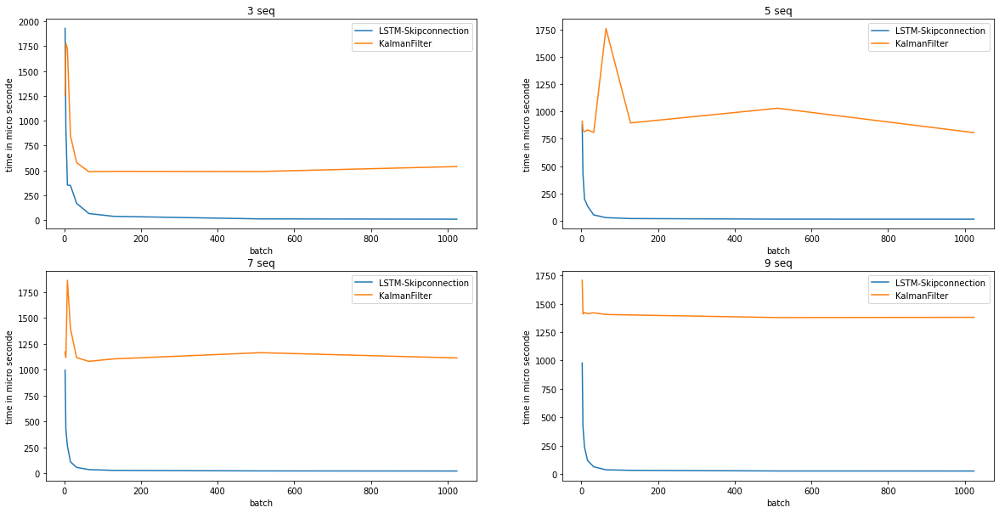

In [ ]:
plt.figure(figsize=(20, 10))
plt.subplot(221)
plt.title('3 seq')
plt.plot(batch_size, average_time3, label='LSTM-Skipconnection')
plt.plot(batch_size, average_time_kalman3,  label='KalmanFilter')
plt.xlabel('batch')
plt.ylabel('time in micro seconde')
plt.legend()

plt.subplot(222)
plt.title('5 seq')
plt.plot(batch_size, average_time5, label='LSTM-Skipconnection')
plt.plot(batch_size, average_time_kalman5,  label='KalmanFilter')
plt.xlabel('batch')
plt.ylabel('time in micro seconde')
plt.legend()

plt.subplot(223)
plt.title('7 seq')
plt.plot(batch_size, average_time7, label='LSTM-Skipconnection')
plt.plot(batch_size, average_time_kalman7,  label='KalmanFilter')
plt.xlabel('batch')
plt.ylabel('time in micro seconde')
plt.legend()

plt.subplot(224)
plt.title('9 seq')
plt.plot(batch_size, average_time9, label='LSTM-Skipconnection')
plt.plot(batch_size, average_time_kalman9,  label='KalmanFilter')
plt.xlabel('batch')
plt.ylabel('time in micro seconde')
plt.legend()

plt.show()

[1296, 1287, 1278, 1269, 1261, 1253, 1245, 1237, 1230]


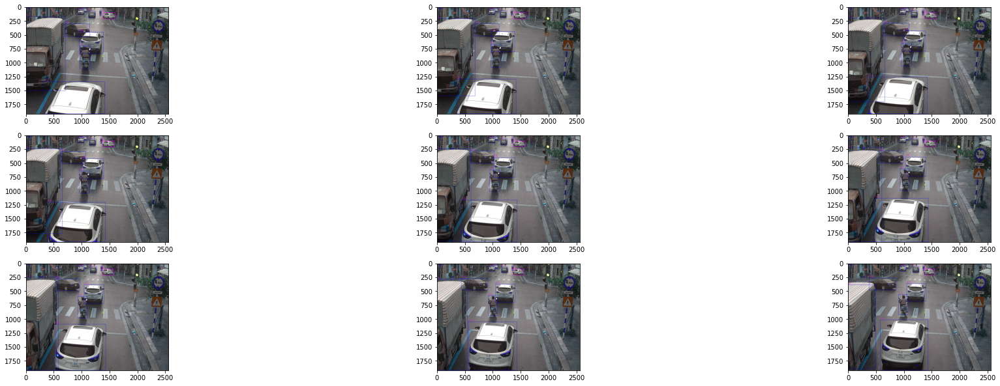

<Figure size 432x288 with 0 Axes>

In [88]:
# #visualise
import cv2
import matplotlib.pyplot as plt
id = 315
fig = plt.figure(figsize=(32, 32))
print(train_list[0][:-1])
# for id in train_list[0][:-1]:
for i in range(len(train_list[id][:-1])):
    try:
      anno = coco_test_annotation.loadAnns(train_list[id][i])[0]
      image_id = anno['image_id']
      xl,yl,w,h = anno['bbox']
      img_path = root_dir + '/images/' + coco_test_annotation.loadImgs([image_id])[0]['file_name']
    except:
      anno = coco_annotation.loadAnns(train_list[id][i])[0]
      image_id = anno['image_id']
      xl,yl,w,h = anno['bbox']
      img_path = root_dir + '/images/' + coco_annotation.loadImgs([image_id])[0]['file_name']
    img = cv2.imread(img_path)
    img = cv2.rectangle(img, (int(xl), int(yl)), (int(xl+w), int(yl+h)), (255,0,255), 3)
    fig.add_subplot(9,3,i+1)
    plt.imshow(img)
plt.show()
plt.savefig('input.png')

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


[0.7796139, 0.0005007522, 0.79909414, 0.04494596]


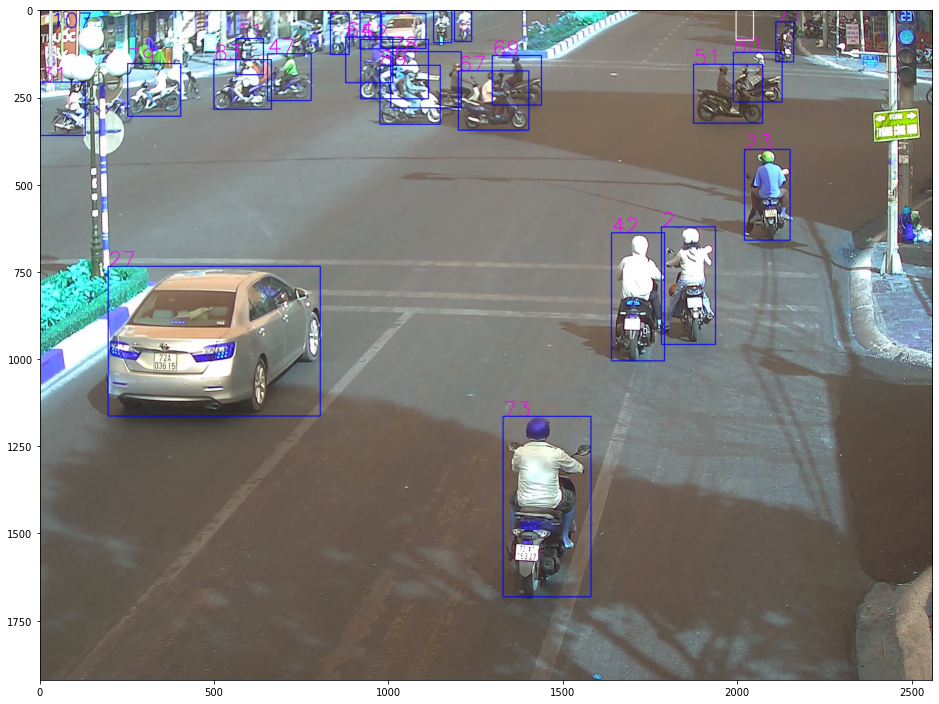

In [101]:
# # model.load_weights('/content/drive/MyDrive/viettle/miniproject/sequencer/output/checkpointfortrajectory2')
# #tạo dataset
# import cv2
# num_frames_input = 10
# list_ID = create_list_ID(coco_annotation, coco_test_annotation)
# for key in list_ID.keys():
#   list_ID[key].sort(key=vid_path)
#   b = [a[0] for a in list_ID[key]]
#   list_ID[key] = b
# train_list = create_train_list(list_ID, num_frames_input)
# x_scale, y_scale = create_dataset(train_list, coco_annotation, coco_test_annotation)

# path_save = './output/5lstm_CIOULoss.bestweight{}'.format(num_frames_input)
# checkpoint = torch.load(path_save)
# model.load_state_dict(checkpoint['model_state_dict'])
# model = model.cuda()
# model.eval()

w = 2560
h = 1920
with torch.no_grad():
  # coco_test_annotation_file_path = os.path.join(root_dir, 'val.json')
  # coco_test_annotation = COCO(annotation_file=coco_test_annotation_file_path)
  id = 91001
  try:
    anno = coco_test_annotation.loadAnns(train_list[id][-1])[0]
    image_id = anno['image_id']
    img_path = root_dir + '/images/' + coco_test_annotation.loadImgs([image_id])[0]['file_name']
  except:
    anno = coco_annotation.loadAnns(train_list[id][-1])[0]
    image_id = anno['image_id']
    img_path = root_dir + '/images/' + coco_annotation.loadImgs([image_id])[0]['file_name']
    
  img = cv2.imread(img_path)
  xt, yt, xr, yr = np.array((model(torch.tensor(x_scale[np.newaxis, id]).cuda())).cpu())
  print([xt,yt,xr,yr])
  xt *= w
  yt *= h
  xr *= w
  yr *= h
  img = cv2.rectangle(img, (int(xt), int(yt)), (int(xr), int(yr)), (255,255,255), 2)
  fig = plt.figure(figsize=(16, 16))
  cv2.imwrite('example{}.png'.format(num_frames_input), img)
  plt.imshow(img)
  plt.show()



/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


[0.5412556, 0.059309322, 0.63490146, 0.11622127]


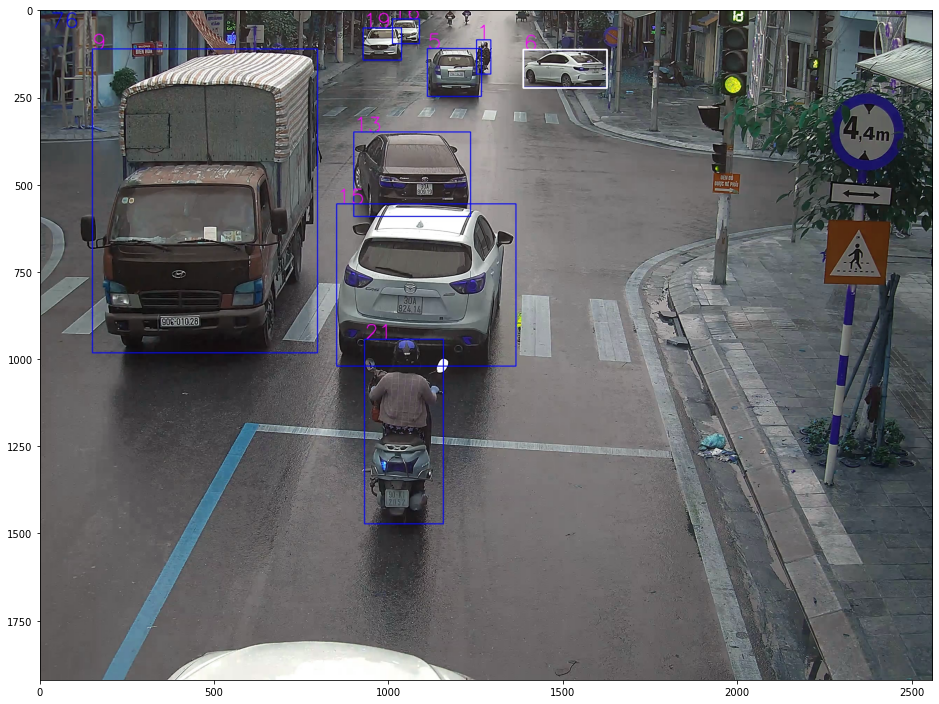

In [90]:
# # model.load_weights('/content/drive/MyDrive/viettle/miniproject/sequencer/output/checkpointfortrajectory2')
#tạo dataset
import cv2
num_frames_input = 4
list_ID = create_list_ID(coco_annotation, coco_test_annotation)
for key in list_ID.keys():
  list_ID[key].sort(key=vid_path)
  b = [a[0] for a in list_ID[key]]
  list_ID[key] = b
train_list = create_train_list(list_ID, num_frames_input)
x_scale, y_scale = create_dataset(train_list, coco_annotation, coco_test_annotation)

path_save = './output/5lstm_CIOULoss.bestweight{}'.format(num_frames_input)
checkpoint = torch.load(path_save)
model.load_state_dict(checkpoint['model_state_dict'])
model = model.cuda()
model.eval()

w = 2560
h = 1920
with torch.no_grad():
  # coco_test_annotation_file_path = os.path.join(root_dir, 'val.json')
  # coco_test_annotation = COCO(annotation_file=coco_test_annotation_file_path)
  id = 315
  try:
    anno = coco_test_annotation.loadAnns(train_list[id][-1])[0]
    image_id = anno['image_id']
    img_path = root_dir + '/images/' + coco_test_annotation.loadImgs([image_id])[0]['file_name']
  except:
    anno = coco_annotation.loadAnns(train_list[id][-1])[0]
    image_id = anno['image_id']
    img_path = root_dir + '/images/' + coco_annotation.loadImgs([image_id])[0]['file_name']
    
  img = cv2.imread(img_path)
  xt, yt, xr, yr = np.array((model(torch.tensor(x_scale[np.newaxis, id]).cuda())).cpu())
  print([xt,yt,xr,yr])
  xt *= w
  yt *= h
  xr *= w
  yr *= h
  img = cv2.rectangle(img, (int(xt), int(yt)), (int(xr), int(yr)), (255,255,255), 4)
  fig = plt.figure(figsize=(16, 16))
  plt.imshow(img)
  cv2.imwrite('example{}.png'.format(num_frames_input), img)
  plt.show()

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


[0.537689, 0.059022777, 0.6324516, 0.11539771]


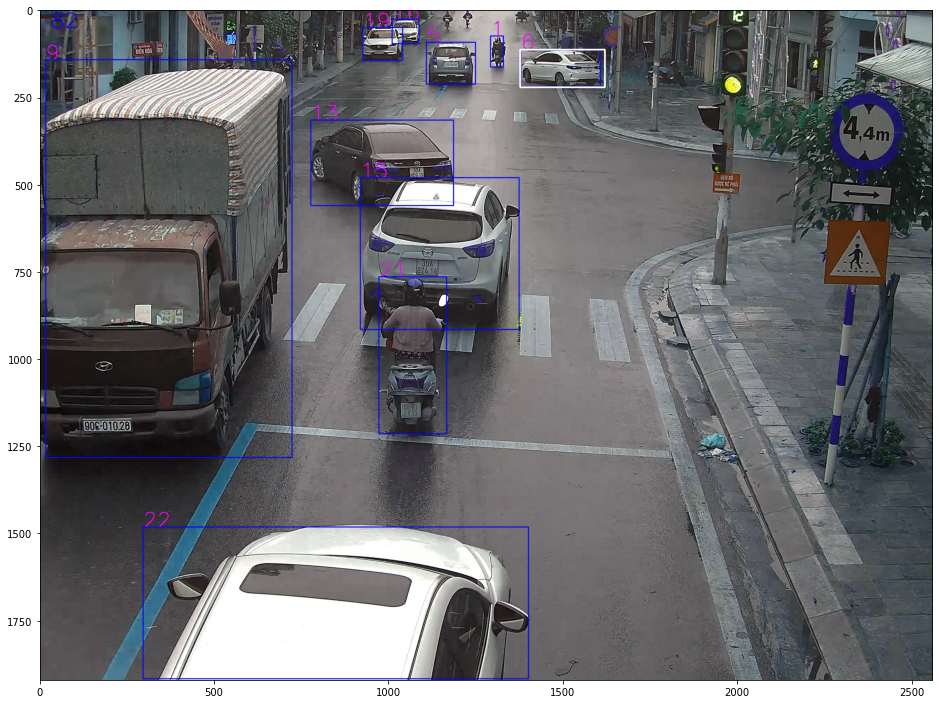

In [89]:
# # model.load_weights('/content/drive/MyDrive/viettle/miniproject/sequencer/output/checkpointfortrajectory2')
#tạo dataset
import cv2
num_frames_input = 6
list_ID = create_list_ID(coco_annotation, coco_test_annotation)
for key in list_ID.keys():
  list_ID[key].sort(key=vid_path)
  b = [a[0] for a in list_ID[key]]
  list_ID[key] = b
train_list = create_train_list(list_ID, num_frames_input)
x_scale, y_scale = create_dataset(train_list, coco_annotation, coco_test_annotation)

path_save = './output/5lstm_CIOULoss.bestweight{}'.format(num_frames_input)
checkpoint = torch.load(path_save)
model.load_state_dict(checkpoint['model_state_dict'])
model = model.cuda()
model.eval()

w = 2560
h = 1920
with torch.no_grad():
  # coco_test_annotation_file_path = os.path.join(root_dir, 'val.json')
  # coco_test_annotation = COCO(annotation_file=coco_test_annotation_file_path)
  id = 315
  try:
    anno = coco_test_annotation.loadAnns(train_list[id][-1])[0]
    image_id = anno['image_id']
    img_path = root_dir + '/images/' + coco_test_annotation.loadImgs([image_id])[0]['file_name']
  except:
    anno = coco_annotation.loadAnns(train_list[id][-1])[0]
    image_id = anno['image_id']
    img_path = root_dir + '/images/' + coco_annotation.loadImgs([image_id])[0]['file_name']
    
  img = cv2.imread(img_path)
  xt, yt, xr, yr = np.array((model(torch.tensor(x_scale[np.newaxis, id]).cuda())).cpu())
  print([xt,yt,xr,yr])
  xt *= w
  yt *= h
  xr *= w
  yr *= h
  img = cv2.rectangle(img, (int(xt), int(yt)), (int(xr), int(yr)), (255,255,255), 3)
  fig = plt.figure(figsize=(16, 16))
  cv2.imwrite('example{}.png'.format(num_frames_input), img)
  plt.imshow(img)
  plt.show()
  

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:651: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool1d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


[0.5351918, 0.049876876, 0.6236253, 0.111439966]


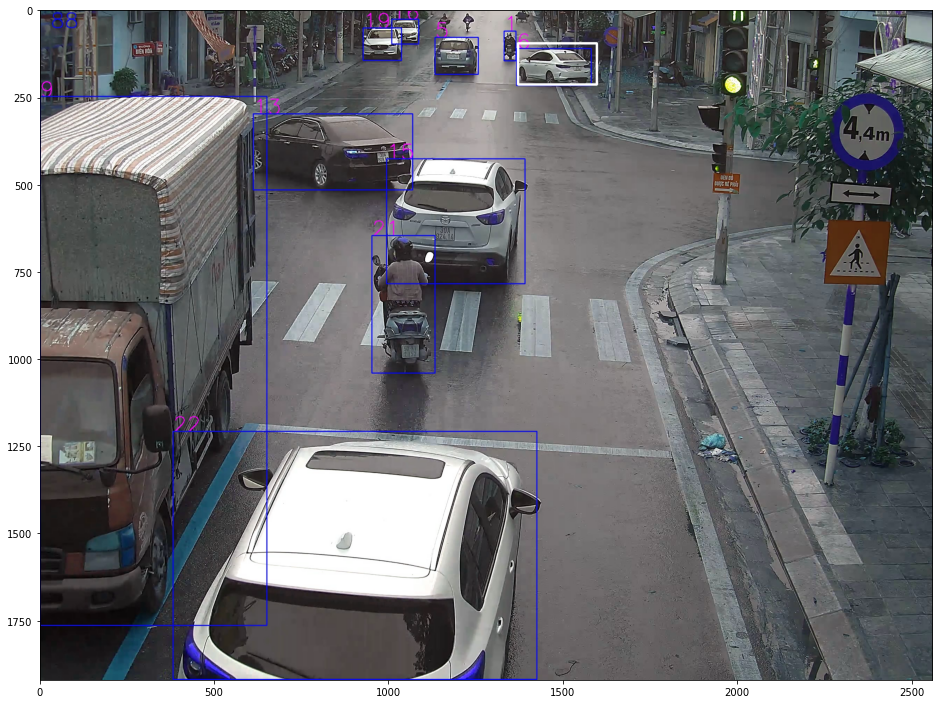

In [92]:
# # model.load_weights('/content/drive/MyDrive/viettle/miniproject/sequencer/output/checkpointfortrajectory2')
#tạo dataset
import cv2
num_frames_input = 8
list_ID = create_list_ID(coco_annotation, coco_test_annotation)
for key in list_ID.keys():
  list_ID[key].sort(key=vid_path)
  b = [a[0] for a in list_ID[key]]
  list_ID[key] = b
train_list = create_train_list(list_ID, num_frames_input)
x_scale, y_scale = create_dataset(train_list, coco_annotation, coco_test_annotation)

model.eval()
w = 2560
h = 1920
with torch.no_grad():
  # coco_test_annotation_file_path = os.path.join(root_dir, 'val.json')
  # coco_test_annotation = COCO(annotation_file=coco_test_annotation_file_path)
  id = 315
  try:
    anno = coco_test_annotation.loadAnns(train_list[id][-1])[0]
    image_id = anno['image_id']
    img_path = root_dir + '/images/' + coco_test_annotation.loadImgs([image_id])[0]['file_name']
  except:
    anno = coco_annotation.loadAnns(train_list[id][-1])[0]
    image_id = anno['image_id']
    img_path = root_dir + '/images/' + coco_annotation.loadImgs([image_id])[0]['file_name']
    
  img = cv2.imread(img_path)
  xt, yt, xr, yr = np.array((model(torch.tensor(x_scale[np.newaxis, id]).cuda())).cpu())
  print([xt,yt,xr,yr])
  xt *= w
  yt *= h
  xr *= w
  yr *= h
  img = cv2.rectangle(img, (int(xt), int(yt)), (int(xr), int(yr)), (255,255,255), 5)
  fig = plt.figure(figsize=(16, 16))
  cv2.imwrite('example{}.png'.format(num_frames_input), img)
  plt.imshow(img)
  plt.show()

In [ ]:
# # model.load_weights('/content/drive/MyDrive/viettle/miniproject/sequencer/output/checkpointfortrajectory1')
# import cv2

# anno = coco_test_annotation.loadAnns(test_list[1000][-1])[0]
# image_id = anno['image_id']
# xl,yl,w,h = anno['bbox']
# img_path = root_dir + '/images/' + coco_test_annotation.loadImgs([image_id])[0]['file_name']
# img = cv2.imread(img_path)
# img = cv2.rectangle(img, (int(xl), int(yl)), (int(xl+w), int(yl+h)), (255,0,255), 3)
# fig = plt.figure(figsize=(32, 32))
# plt.imshow(img)
# plt.show()

In [52]:
x_scale[0], y_scale[0], 

(array([[0.5214492 , 0.36808333, 0.5926836 , 0.57463545],
        [0.5173242 , 0.35866666, 0.5868945 , 0.5588125 ],
        [0.5145    , 0.35152605, 0.5829922 , 0.5468125 ]], dtype=float32),
 array([0.5125625 , 0.34144792, 0.5779961 , 0.52751565], dtype=float32))

In [ ]:
#315
model = LSTMRegression(input_dim, hidden_dim, output_dim)
checkpoint = torch.load(path_save)
model.load_state_dict(checkpoint['model_state_dict'])
model = model.cuda()
model.eval()
with torch.no_grad():
  